## Importing libraries

In [ ]:
!pip install torch
!pip install transformers

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.1/7.1 MB 96.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 236.8/236.8 kB 29.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 117.7 MB/s eta 0:00:00


In [ ]:
!pip install scikit-learn spacy
!pip install https://s3-us-west-2.amazonaws.com/ai2-s2-scispacy/releases/v0.4.0/en_core_sci_lg-0.4.0.tar.gz
!pip install https://s3-us-west-2.amazonaws.com/ai2-s2-scispacy/releases/v0.4.0/en_core_sci_sm-0.4.0.tar.gz
!pip install https://s3-us-west-2.amazonaws.com/ai2-s2-scispacy/releases/v0.4.0/en_core_sci_md-0.4.0.tar.gz

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 538.1/538.1 MB 2.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.9/5.9 MB 15.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 659.5/659.5 kB 49.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 126.0/126.0 kB 17.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 82.8/82.8 kB 11.6 MB/s eta 0:00:00
  Created wheel for en-core-sci-lg: filename=en_core_sci_lg-0.4.0-py3-none-any.whl size=538899668 sha256=23b18deabb06ea65f14103a2c4b0efb516266e3bc6cba9b3401d3da759cc2af5
  Stored in directory: /root/.cache/pip/wheels/36/92/84/470f08aaceedc52e78ea9127780e62e7c4c4e676d922a7493b
Successfully built en-core-sci-lg
  Attempting uninstall: wasabi
    Found existi

In [ ]:
import numpy as np
import pandas as pd
import os
from random import shuffle
import re
import urllib.request
import zipfile
import lxml.etree
from nltk.corpus import stopwords
from nltk.tokenize import RegexpTokenizer
import spacy
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics.pairwise import cosine_similarity

from sklearn.metrics import confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt
sns.set(style="whitegrid")


import torch
from transformers import AutoTokenizer, AutoModel
import scipy



In [ ]:
from nltk.tokenize import word_tokenize
from nltk.corpus import wordnet
from nltk.stem import WordNetLemmatizer
import nltk

nltk.download('stopwords')
nltk.download('omw-1.4')
nltk.download('punkt')
nltk.download('stopwords')
nltk.download('wordnet')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package omw-1.4 to /root/nltk_data...
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to /root/nltk_data...


True

In [ ]:
!pip install PyPDF2
import PyPDF2

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 232.6/232.6 kB 7.6 MB/s eta 0:00:00


## Get word list function used for all cases, initialize thsi function before any course word2vec model

In [ ]:
def get_word_list(input_text):
  sentences = input_text.split('\n')
  #len(sentences)
  word_list = []
  #create word tokens as well as remove puntuation in one go
  for sentence in sentences:
    rem_tok_punc = RegexpTokenizer(r'\w+')

    tokens = rem_tok_punc.tokenize(sentence)

    #convert the words to lower case
    words = [w.lower() for w in tokens]

    #Invoke all the english stopwords

    #stop_word_list = set(stopwords.words('english'))

    #Remove stop words
    #words = [w for w in words if not w in stop_word_list]
    word_list.append(words)

  #Append words in the review_data_list list.
  #len(word_list)
  return word_list

## Function to score similarity using multiple answers from marking scheme, used for all courses run after training on spacy. BERT model is in physics responses heading.

In [ ]:
stop_words = set(stopwords.words("english"))
stop_words.discard("not")

lemmatizer = WordNetLemmatizer()

def preprocess(sentence):
    tokens = word_tokenize(sentence)
    tokens = [word.lower() for word in tokens if word.isalpha() and word.lower() not in stop_words]
    return " ".join(tokens)

#Function defined for 2 marks question
#def get_similarity(ms,ans,nlp):
#  scores = []
#  s2 = nlp((ans.lower()))

#  for i in range(len(ms)):
#     score = 0
#    matching_ms = ""
#    for m in ms[i]:
#      s1 = nlp(m.lower())
#      similarity_score = s1.similarity(s2)
#      print(m,similarity_score)
#      score = max(score,similarity_score)
#    print(score)
#    scores.append(score)
#  print()
#  score = sum(scores)/len(scores)
#  return score

#Function to get max score and its marking_scheme
def get_similarity(ms,ans,nlp):
  scores = []
  s2 = nlp((ans.lower()))

  for i in range(len(ms)):
    score = 0
    matching_ms = ""
    for m in ms[i]:
      s1 = nlp(m.lower())
      similarity_score = s1.similarity(s2)
      print(m,similarity_score)
      if similarity_score > score:
        score = similarity_score
      score = max(score,similarity_score)
      matching_ms = s1
    print(score)
    scores.append(score)
  print()
  score = sum(scores)/len(scores)
  return score, matching_ms

def get_similarity_binary(ms,ans,nlp):
  scores = []
  s2 = nlp((ans.lower()))

  for i in range(len(ms)):
    score = 0
    for m in ms[i]:
      s1 = nlp(m.lower())
      similarity_score = s1.similarity(s2)
      print(m,similarity_score)
      score = max(score,similarity_score)
    print(score)
    scores.append(score)
  print()
  score = sum(scores)/len(scores)
  return scores



def get_similarity_concatenated(ms,ans,nlp):
  score = 0

  if len(ms) == 1:
    return get_similarity(ms,ans,nlp)

  s1 = nlp(ans.lower())
  for i in range(len(ms[0])):
    for j in range(len(ms[1])):
      m = ms[0][i] + " " + ms[1][j]
      s2 = nlp(m.lower())
      similarity_score = s1.similarity(s2)
      print(m,similarity_score)
      score = max(score,similarity_score)
  return score

## Physics model and cases

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
files = [file for file in os.listdir("/content/drive/MyDrive/FYP Books")]
print("Number of Books:",len(files),'\n')
for file in files:
    print(file)

Number of Books: 25 

Cambridge IGCSE Physics (3rd edition) by Tom Duncan and Heather Kennett.pdf
O-LEVEL-PHYSICS-TEXT-BOOK.pdf
Cambridge-International-AS-and-A-Level-Physics-Coursebook-PDFDrive.com-.pdf
Cambridge IGCSE Physics.pdf
Cambridge International AS and A Level Physics, 2nd edition ( PDFDrive ).pdf
K.-A.-Tsokos-Peter-Hoeben-Mark-Headlee-Physics-for-the-IB-Diploma-Coursebook-Cambridge-University-Press-2014-1.pdf
Modern Physics.pdf
01. University Physics Volume 1 author Samuel J. Ling, Jeff Sanny, William Moebs.pdf
03. University Physics Volume 3 author Samuel J. Ling, Jeff Sanny, William Moebs.pdf
02. University Physics Volume 2 author Samuel J. Ling, Jeff Sanny, William Moebs.pdf
04. College Physics - Volume 1 of 3 author Textbook Equity Open Education.pdf
05. College Physics - Volume 2 of 3 author Textbook Equity Open Education.pdf
06. College Physics - Volume 3 of 3 author Textbook Equity Open Education.pdf
07. Introductory Physics I author Robert Brown.pdf
08. Introductory 

### Pdf file conversion code

In [ ]:

def file_conversion(files):
  data = ""
  book_num = 1
  for file in files:
        # creating a pdf file object
    count = str(book_num) + '/' + str(len(files))
    print("Reading",count," Book Name:",file)
    book_num += 1

    filename = "/content/drive/MyDrive/FYP Books/" + file
    pdfFileObj = open(filename, 'rb') #Physics_Book_For_embedding.pdf

        # creating a pdf reader object
    pdfReader = PyPDF2.PdfReader(pdfFileObj)

        # printing number of pages in pdf file
        #print(pdfReader.numPages)

        # creating a page object
    for i in range(len(pdfReader.pages)):
            #print("Page Number",i+1)
        pageObj = pdfReader.pages[i]

            # extracting text from page
        data += pageObj.extract_text()

        # closing the pdf file object
    pdfFileObj.close()
  return data

input_text = file_conversion(files)

Reading 1/25  Book Name: Cambridge IGCSE Physics (3rd edition) by Tom Duncan and Heather Kennett.pdf
Reading 2/25  Book Name: O-LEVEL-PHYSICS-TEXT-BOOK.pdf
Reading 3/25  Book Name: Cambridge-International-AS-and-A-Level-Physics-Coursebook-PDFDrive.com-.pdf
Reading 4/25  Book Name: Cambridge IGCSE Physics.pdf
Reading 5/25  Book Name: Cambridge International AS and A Level Physics, 2nd edition ( PDFDrive ).pdf
Reading 6/25  Book Name: K.-A.-Tsokos-Peter-Hoeben-Mark-Headlee-Physics-for-the-IB-Diploma-Coursebook-Cambridge-University-Press-2014-1.pdf
Reading 7/25  Book Name: Modern Physics.pdf
Reading 8/25  Book Name: 01. University Physics Volume 1 author Samuel J. Ling, Jeff Sanny, William Moebs.pdf
Reading 9/25  Book Name: 03. University Physics Volume 3 author Samuel J. Ling, Jeff Sanny, William Moebs.pdf
Reading 10/25  Book Name: 02. University Physics Volume 2 author Samuel J. Ling, Jeff Sanny, William Moebs.pdf
Reading 11/25  Book Name: 04. College Physics - Volume 1 of 3 author Text

###  Creating genism model for wordlist

In [ ]:
from gensim.models import Word2Vec
word_list = get_word_list(input_text)
model = Word2Vec(sentences=word_list, window=8, min_count=5, workers=4, sg=0)

In [ ]:
len(word_list)

369846

In [ ]:
stop_words = stopwords.words('english')

def preprocess(sentence):
    return [w for w in sentence.lower().split() if w not in stop_words]

In [ ]:
model.wv.save_word2vec_format("model.bin", binary=True)

### Using spacy

In [ ]:
import spacy
from gensim.models import KeyedVectors

# Load the pre-trained Word2Vec embeddings
word_vectors = KeyedVectors.load_word2vec_format("model.bin", binary=True)

# Load a blank English model
nlp_w2v = spacy.blank("en")

# Add the word vectors to the vocabulary
for word in word_vectors.index_to_key:
    #5print(word)
    nlp_w2v.vocab.set_vector(word, word_vectors.get_vector(word))

In [ ]:
type(word_vectors)

gensim.models.keyedvectors.KeyedVectors

In [ ]:
# vocab_size, vector_size = word_vectors.syn0.shape
# print("Vocabulary size:", vocab_size)
# print("Vector size:", vector_size)

### Preprocess function used for student answer and marking scheme

---



In [ ]:
stop_words = set(stopwords.words("english"))
stop_words.discard("not")

lemmatizer = WordNetLemmatizer()

def preprocess(sentence):
    tokens = word_tokenize(sentence)
    tokens = [lemmatizer.lemmatize(word.lower()) for word in tokens if word.isalpha() and word.lower() not in stop_words]
    return " ".join(tokens)

###Test Case 01

In [ ]:
marking_scheme = {
  0 : ["molecules move faster",
  "vibrate faster",
  "have more kinetic energy",
  "have more potential energy",
  "have more internal energy",
  "have more energy",
  "molecules move apart",
  "distance between molecules increases",
  "vibration has larger amplitude",
  "vibration takes up more space",
  "bonds stretch"]
}

####1/2

In [ ]:
student_answer = "When solids are heated the molecules in the solids gain kinetic energy and begin to vibrate more vigorously about their fixed positions. In doing so, each molecule transfers kinetic energy to its neighbouring molecule and this weakens the forces of attraction between the molecules of the solid."
print("Similarity score between marking scheme and student answer: ",get_similarity(marking_scheme, student_answer,nlp_w2v))

molecules move faster 0.660911961509793
vibrate faster 0.529344909267524
have more kinetic energy 0.7067905292768131
have more potential energy 0.6530632765192478
have more internal energy 0.6786457496100033
have more energy 0.630337869944754
molecules move apart 0.6310193519604662
distance between molecules increases 0.6680713582516151
vibration has larger amplitude 0.4182455368693685
vibration takes up more space 0.5865064963093374
bonds stretch 0.47505587276501987
0.7067905292768131

Similarity score between marking scheme and student answer:  (0.7067905292768131, bonds stretch)


####1/2

In [ ]:
student_answer = "When heated, the molecules in a solid move faster. They collide more frequently. The collisions are also high energy collisions. So the molecules of the solid expand. Which expands the solid."
print("Similarity score between marking scheme and student answer: ",get_similarity(marking_scheme, student_answer, nlp_w2v))

molecules move faster 0.7584446201504119
vibrate faster 0.6312910901015805
have more kinetic energy 0.6459588802796675
have more potential energy 0.5971277567124151
have more internal energy 0.6561901941501378
have more energy 0.6308317581442716
molecules move apart 0.7153398729218119
distance between molecules increases 0.6247685440449863
vibration has larger amplitude 0.3870326540441212
vibration takes up more space 0.6288378353852714
bonds stretch 0.4805751843009908
0.7584446201504119

Similarity score between marking scheme and student answer:  (0.7584446201504119, bonds stretch)


####1/2

In [ ]:
student_answer = "Because when the solid molecules heated it gains kinetic energy the molecules vibrating so the molecules expand when heated. It gain enough energy to break the forces attraction."
print("Similarity score between marking scheme and student answer: ",get_similarity(marking_scheme, student_answer, nlp_w2v))

molecules move faster 0.6937675338225481
vibrate faster 0.564214480604696
have more kinetic energy 0.682465452124663
have more potential energy 0.6312205266090843
have more internal energy 0.6622425711169339
have more energy 0.6071609421893029
molecules move apart 0.6540032946919474
distance between molecules increases 0.6193837903656437
vibration has larger amplitude 0.3400179656945908
vibration takes up more space 0.5675956534473618
bonds stretch 0.4662313046910268
0.6937675338225481

Similarity score between marking scheme and student answer:  (0.6937675338225481, bonds stretch)


In [ ]:
ms = {
    0 : ["vector quantity has direction",
        "scalar quantity does not have direction"]
}

In [ ]:
ans = "vector does not have direction"

In [ ]:
get_similarity(ms,ans, nlp_w2v)

vector quantity has direction 0.7896522897428601
scalar quantity does not have direction 0.9563737340880855
0.9563737340880855



(0.9563737340880855, scalar quantity does not have direction)

###Test Case 02

In [ ]:
marking_scheme = {
    0 : ["Force causes moment",
    "Resultant causes moment",
    "turns because force is not at pivot"]
}

####0/1

In [ ]:
student_answer = "The magnetic poles attract the compass needle."
print("Similarity score between marking scheme and student answer: ",get_similarity(marking_scheme, student_answer, nlp))

NameError: ignored

####0/1

In [ ]:
student_answer = "When the finger is removed the needle would turn to show the direction magnetic field."
print("Similarity score between marking scheme and student answer: ",get_similarity(marking_scheme, student_answer, nlp))

####0/1

In [ ]:
student_answer = "It is attract by north pole."
print("Similarity score between marking scheme and student answer: ",get_similarity(marking_scheme, student_answer, nlp))

###Test Case 03

In [ ]:
marking_scheme = {
    0 : ["Heat energy produced",
    "thermal energy produced",
    "Sound produced",
    "work done against friction",
    "work done against air resistance"]
}

####1/1

In [ ]:
student_answer = "The decrease in the potential energy is less as some energy is lost as heat."
print("Similarity score between marking scheme and student answer: ",get_similarity(marking_scheme, student_answer, nlp))

####0/1

In [ ]:
student_answer = "Because the girl is falling with greater energy so K.E increases and potential energy is less."
print("Similarity score between marking scheme and student answer: ",get_similarity(marking_scheme, student_answer, nlp))

####0/1

In [ ]:
student_answer = "it is due to her less movement that made her kinetic energy gain less."
print("Similarity score between marking scheme and student answer: ",get_similarity(marking_scheme, student_answer, nlp))

###Test Case 04

In [ ]:
marking_scheme = {
  0:["hot water rises",
  "hot air rises",
  "hot air over water rises"],

  1:["hot air expands",
  "hot water expands",
  "hot air less dense",
  "hot water less dense"]
}

####2/2

In [ ]:
student_answer = "When hit water comes in contact with air. It losed its energy, to air which beomes hot, less dense and rises. Cold air replaces it. The process continues and water loses heat."
print("Similarity score between marking scheme and student answer: ",get_similarity(marking_scheme, student_answer, nlp))

####1/2

In [ ]:
student_answer = "In convection heat is transmitted from a place to another through the movement of molecules to the moleules gets heat, they become less dense and rise in their place denser molecules comes. repeated heat loss process."
print("Similarity score between marking scheme and student answer: ",get_similarity(marking_scheme, student_answer, nlp))

####1/2

In [ ]:
student_answer = "The water in a pan loses heat by convection. Convection currents are set in water due to difference in densities at various parts in water. Heat is lost due to convection currents."
print("Similarity score between marking scheme and student answer: ",get_similarity(marking_scheme, student_answer, nlp))

###Test Case 05

In [ ]:
marking_scheme = {
    0 : ["constant increase in velocity",
    "same increase in velocity",
    "constant change in velocity",
    "constant increase in velocity per sec time",
    "same increase in velocity per unit time"]
}

####2/2

In [ ]:
student_answer = "Uniform acceleration means that sudden change in speed that is happening in an uniform or constant rate."
print("Similarity score between marking scheme and student answer: ",get_similarity(marking_scheme, student_answer, nlp))

####1/2

In [ ]:
student_answer = "When the forward force is greater than the backward force and the velocity of the car is changing constantly with time."
print("Similarity score between marking scheme and student answer: ",get_similarity(marking_scheme, student_answer, nlp))

####0/2

In [ ]:
student_answer = "Uniform acceleration is that object is moving with constant velocity where as moving with same speed respectively."
print("Similarity score between marking scheme and student answer: ",get_similarity(marking_scheme, student_answer, nlp))

###Test Case 06

In [ ]:
marking_scheme = {
    0 : ["Conduction occurs through metal",
    "conduction occurs through pan",
    "conduction occurs from water to metal",
    "conduction occurs from water to pan",
    "molecules vibrate",
    "molecules collide",
    "free electrons in metal move"] ,

    1 : ["vibration passed from molecule to molecule clear",
    "energy passed on by electrons colliding with atoms",
    "energy passed on by electrons colliding with molecules or electrons"]
}

####2/2

In [ ]:
student_answer = "Conduction takes place in the metal. The vibrating particles in the solid metal loses their energy to the neighbouring particles due to collision and the pan loses heat."
print("Similarity score between marking scheme and student answer: ",get_similarity(marking_scheme, student_answer, nlp))

####1/2

In [ ]:
student_answer = "Conduction is way of heat travelling. In this heat is travel by through the vibration of molecule. As the molecules vibrate, they collide, kinetic energy increases as a result loss of heat in water."
print("Similarity score between marking scheme and student answer: ",get_similarity(marking_scheme, student_answer, nlp))

####1/2

In [ ]:
student_answer = "The water in a pan loses heat by conduction. The heat energy of the water molecules is absorbed by the wall of sauce pan and escapes in the surrounding."
print("Similarity score between marking scheme and student answer: ",get_similarity(marking_scheme, student_answer, nlp))

# Physics Student Responses

### Definging Marking Scheme

In [ ]:
marking_scheme = [
{
    0 : ["vector quantity has direction",
        "scalar quantity does not have direction"]
},
{
    0 : ["force multiplied by distance"],
    1 : ["force multiplied by perpendicular distance"]
},
{
    0 : ["temperature of melting ice",
         "temperature of freezing water"]
},
{
    0 : ["speed remains the same"],
    1 : ["wavelength decreases"]
},
{
    0 : ["Force per unit area"]
},
{
    0 : ["Molecules have more kinetic energy",
        "Molecules have more speed",
        "Molecules have more velocity"],
    1 : ["Hits sides harder",
        "Hits sides with more force",
        "Hits sides more often",
        "Hits sides more frequently",
        "Creates larger pressure"]
},
{
    0 : ["Radiation when there is no source",
         "Naturally occurring radiation",
         "Radiation that is always present"
        ]
},
{
    0 : ["(average) time (taken for)"],
    1 : ["Count rate to halve",
         "number of nuclei to halve",
         "number of atoms to halve"]
},
{
    0 : ["Provides smaller (internal) resistance",
         "Lasts longer",
         "Less lost voltage",
         "One (cell) fails others work",
         "Less heat lost",
         "Less energy lost"]
},
{
    0 : ["Current proportional to voltage"],
    1 : ["Provided temperature unchanged",
         "Provided physical conditions unchanged"]
},
{
    0 : ["no costs for water or energy supply",
         "Coal produces smoke or dust or harmful gases or Carbondixoide hence less pollution",
         "No need to transport coal or renewable",
         "Rapid response to power demand",
         "Less heat produced or more effecient"]
},
{
    0 : ["molecules move faster",
         "Molecules have higher energy"],
    1 : ["more molecules have energy",
         "Molecules have speed to break bonds",
         "Molecules overcome forces"]
},
{
    0 : ["molecules hit each other",
         "Molecules pass vibration on",
         "Free electrons move through metal and hit molecules"]
},
{
    0 : ["fiberglass or air is a bad conductor or insulator",
         "Reduces heat flow"],
    1 : ["fiberglass traps air",
         "Prevents convection"]
},
{
    0 : ["number of complete waves or cycles",
         "Oscillations per unit time or second"]
},
{
    0 : ["Wavelength decreases"],
    1 : ["travels a shorter distance in the same time",
         "Frequency stays the same"]
},
{
    0 : ["Water molecules close",
         "Water molecules closer",
         "Water molecules move in clusters",
         "Water molecules move within the liquid",
         "Air molecules far apart",
         "Air molecules further apart",
         "Air molecules move individually",
         "Air molecules move throughout the container"]
},
{
    0 : ["more water above",
         "more force from water",
         "more atoms above",
         "more molecules above"],
    1 : ["larger weight of water above"]
},
{
    0 : ["measures small changes in temperature",
         "measures smaller change in temperature",
         "Small range for same distance",
         "Smaller range for same distance",
         "Large expansion for same temperature rise",
         "Larger expansion for same temperature rise"]
},
{
    0 : ["mercury contracts",
         "Liquid contracts"],
    1 : ["mercury breaks",
         "Liquid breaks",
         "Thread breaks",
         "mercury breaks at the constriction",
         "Liquid breaks at the constriction",
         "Thread breaks at the constriction",
         "Constriction stops the mercury falling back"]
},
{
    0 : ["time between emission varies",
         "Time between emissions unpredictable",
         "Different readings",
         "Different readings when repeated for same time"]
},
{
    0 : ["measure count with no source",
         "Measure count rate with no source"],
    1 : ["subtract from measured count rate",
         "Subtract from measured count",
         "Subtract from count rate",
         "Subtract from count"]
}
]


In [ ]:
n = len(marking_scheme)
n

22

In [ ]:
ms = []
for scheme in marking_scheme:
  #print(type(scheme))
  d = {}
  for key,value in scheme.items():
    lst = []
    for v in value:
      lst.append(preprocess(v))
    d[key] = lst
  ms.append(d)

### Training BERT model

In [ ]:
# Load the pre-trained BERT model and tokenizer
model_name = "bert-base-uncased"
tokenizer = AutoTokenizer.from_pretrained(model_name)
model = AutoModel.from_pretrained(model_name)

Some weights of the model checkpoint at bert-base-uncased were not used when initializing BertModel: ['cls.seq_relationship.weight', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.transform.LayerNorm.bias', 'cls.predictions.transform.dense.bias', 'cls.seq_relationship.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.bias', 'cls.predictions.decoder.weight']
- This IS expected if you are initializing BertModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing BertModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


In [ ]:
input_text

'Physics\nThird Edition Cambridge\nIGCSE®New \nfor 2014\n9781444176421_FM_00.indd   1 20/06/14   7:29 AMThis page intentionally left blank iii\niii\nPhysics\nThird Edition\nT om Duncan \nand Heather KennettNew \nfor 2014Cambridge\nIGCSE®\n9781444176421_FM_00.indd   3 20/06/14   7:29 AM® IGCSE is the registered trademark of Cambridge International Examinations. The questions, example answers, marks \nawarded and/or comments that appear in this book/CD were written by the authors. In examination the way marks \nwould be awarded to answers like these may be different.\nPast examination questions reproduced by permission of Cambridge International Examinations. \nCambridge International Examinations bears no responsibility for the example answers to questions taken from its past \nquestion papers which are contained in this publication.\nAlthough every effort has been made to ensure that website addresses are correct at time of going to press, Hodder \nEducation cannot be held responsible 

In [ ]:
import math
import pickle
import random
import multiprocessing as mp
from transformers import BertTokenizer
from tqdm import tqdm

flatten = lambda t: [item for sublist in t for item in sublist]

tok = BertTokenizer.from_pretrained("bert-base-uncased")
MAX_LEN = 15
BATCH_SIZE = 128

def tokenize(x):
    return tok.encode(x)[1:-1]

def process(_n):
    n = _n
    size = math.ceil(len(n)*0.15)
    indices = random.sample(range(len(n)), size)
    replacement_prob = [True, True, True, True, True, True, True, True, False, False]
    output = [-100]*len(n)
    for index in indices:
        output[index] = n[index]
        if random.choice(replacement_prob):
            n[index] = 103
        else:
            if random.choice([True, False]):
                n[index] = random.randint(1010, 30500)
    return (n, output)

def batcher(ins, outs):
    batchx, batchy, batchesx, batchesy, batchesmasks = [], [], [], [], []
    for i in zip(ins, outs):
        batchx.append(i[0])
        batchy.append(i[1])
        if len(batchx) == BATCH_SIZE:
            maxlen = max([len(x) for x in batchx])
            masks = [[1] * len(x) + [0] * (maxlen - len(x)) for x in batchx]
            batchx = [x + [0] * (maxlen - len(x)) for x in batchx]
            batchy = [x + [0] * (maxlen - len(x)) for x in batchy]
            batchesx.append(batchx)
            batchesy.append(batchy)
            batchesmasks.append(masks)
            batchx = []
            batchy = []
    return [batchesx, batchesy, batchesmasks]

# real_data is an array of strings containing multiple lines, each line is used as its own sample later in the script
real_data = list(set(flatten([x.split("\n") for x in input_text.split("\n\n")])))
print(len(real_data))
random.shuffle(real_data)

pool = mp.Pool()
tokenized = list(tqdm(pool.imap(tokenize, real_data), total=len(real_data)))

inputs = tokenized
outputs = list(tqdm(pool.imap(process, tokenized), total=len(tokenized)))
outputs.sort(key=lambda x: len(x[0]))

inputs = [[101] + x[0] + [102] for x in outputs]
outputs = [[-100] + x[1] + [-100] for x in outputs]

batched = batcher(inputs, outputs)
pickle.dump(batched, open("lblq_data.pkl", "wb"))

#### Fine tuning bert model

In [ ]:
!pip install pytorch_lightning

NotImplementedError: ignored

In [ ]:
import random
import pickle
import numpy as np
import torch
from torch.utils.data import Dataset, DataLoader
import torch.nn.functional as F
import pytorch_lightning as pl
from transformers import BertForMaskedLM

class PTDataset(Dataset):
    def __init__(self):
        self.data = pickle.load(open("lblq_data.pkl", "rb"))
        idxs = list(range(len(self.data[0])))
        random.shuffle(idxs)
        self.data = [[x[i] for i in idxs] for x in self.data]
        print("Loaded {} rows of data".format(len(self.data[0])))

    def __len__(self):
        return len(self.data[0])

    def __getitem__(self, idx):
        return [torch.tensor(x[idx]) for x in self.data]

class BertLyricsPT(pl.LightningModule):
    def __init__(self):
        super().__init__()
        self.bert = BertForMaskedLM.from_pretrained("bert-base-uncased")

    def forward(self, x):
        inp, out, mask = x
        enc = self.bert(input_ids=inp, attention_mask=mask, labels=out)
        return enc

    def training_step(self, batch, batch_nb):
        yhat = self(batch)
        loss = yhat.loss
        return {'loss': loss}

    def configure_optimizers(self):
        return torch.optim.Adam(self.parameters(), lr=5e-5, eps=1e-4)


trainer = pl.Trainer('gpu',max_epochs=4)

dataset = PTDataset()
dataloader = DataLoader(dataset, batch_size=None)

print("Loading model")
model = BertLyricsPT()
print("Loaded model")

trainer.fit(model, dataloader)
model.bert.save_pretrained("bert_lblq")

ModuleNotFoundError: ignored

In [ ]:
import random
import pickle
import numpy as np
import torch
from torch.utils.data import Dataset, DataLoader
import torch.nn.functional as F
from transformers import BertForMaskedLM

class PTDataset(Dataset):
    def __init__(self):
        self.data = pickle.load(open("lblq_data.pkl", "rb"))
        idxs = list(range(len(self.data[0])))
        random.shuffle(idxs)
        self.data = [[x[i] for i in idxs] for x in self.data]
        print("Loaded {} rows of data".format(len(self.data[0])))

    def __len__(self):
        return len(self.data[0])

    def __getitem__(self, idx):
        return [torch.tensor(x[idx]) for x in self.data]

class BertLyricsPT(torch.nn.Module):
    def __init__(self):
        super().__init__()
        self.bert = BertForMaskedLM.from_pretrained("bert-base-uncased")

    def forward(self, x):
        inp, out, mask = x
        enc = self.bert(input_ids=inp, attention_mask=mask, labels=out)
        return enc

    def training_step(self, batch, batch_nb):
        yhat = self(batch)
        loss = yhat.loss
        return {'loss': loss}

    def configure_optimizers(self):
        return torch.optim.Adam(self.parameters(), lr=5e-5, eps=1e-4)

model = BertLyricsPT()
trainer = torch.optim.Adam(model.parameters(), lr=5e-5, eps=1e-4)
dataset = PTDataset()
dataloader = DataLoader(dataset, batch_size=None)

print("Training model")
for epoch in range(4):
    for i, batch in enumerate(dataloader):
        trainer.zero_grad()
        x = batch[:-1]
        y = batch[-1]
        yhat = model(x)
        loss = yhat.loss
        loss.backward()
        trainer.step()
        if i % 500 == 0:
            print(f"Epoch {epoch}, batch {i}, loss: {loss.item()}")

model.bert.save_pretrained("bert_lblq")


Some weights of the model checkpoint at bert-base-uncased were not used when initializing BertForMaskedLM: ['cls.seq_relationship.weight', 'cls.seq_relationship.bias']
- This IS expected if you are initializing BertForMaskedLM from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing BertForMaskedLM from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


Loaded 2501 rows of data
Training model


ValueError: ignored

#### Loading fine tuned bert model

In [ ]:

import sys
from transformers import BertTokenizer, BertForMaskedLM
import torch

model = BertForMaskedLM.from_pretrained("bert_lblq")

In [ ]:
def get_similarity_bert(ms,ans):

  scores = []
  text2 = ans.lower()

  for i in range(len(ms)):
    score = 0
    for m in ms[i]:

      text1 = m.lower()
      # Encode the texts using the BERT tokenizer and add special tokens
      inputs1 = tokenizer.encode_plus(text1, add_special_tokens=True, return_tensors='pt')
      inputs2 = tokenizer.encode_plus(text2, add_special_tokens=True, return_tensors='pt')

      # Pass the encoded texts through the BERT model to obtain contextualized embeddings
      outputs1 = model(**inputs1)
      outputs2 = model(**inputs2)

      # Extract the contextualized embeddings from the BERT outputs
      embeddings1 = outputs1[1].detach().numpy()
      embeddings2 = outputs2[1].detach().numpy()

      # Reshape the embeddings from 2-D to 1-D arrays
      embeddings1 = embeddings1.reshape(-1)
      embeddings2 = embeddings2.reshape(-1)


      # Calculate the similarity between the two texts using cosine similarity
      similarity_score = 1 - scipy.spatial.distance.cosine(embeddings1, embeddings2)

      print(m,similarity_score)
      score = max(score,similarity_score)
    print(score)
    scores.append(score)
  print()
  score = sum(scores)/len(scores)
  return score

### Getting student response and then scoring based on bert and word2vec models

In [ ]:
dfs = []
df_all = pd.DataFrame()
for i in range(n):
  sn = "Q" + str(i+1)
  #df = pd.read_excel("/content/drive/MyDrive/Physics Answer Responses.xlsx",sheet_name=sn, header=0)
  df = pd.read_excel("Physics Answer Responses.xlsx",sheet_name=sn, header=0)
  df['Qs Num'] = i+1
  #df['W2V'] = df['Responses'].apply(lambda x : get_similarity(marking_scheme[i],x,nlp_w2v))
  df[['W2V', 'W2V_ms']] = df['Responses'].apply(lambda x: pd.Series(get_similarity(marking_scheme[i], x, nlp_w2v)))

  df['Bert'] = df['Responses'].apply(lambda x : get_similarity_bert(marking_scheme[i],x))

  df_all = df_all.append(df)
  dfs.append(df)


vector quantity has direction 0.7233921629795685
scalar quantity does not have direction 0.8084903582663077
0.8084903582663077

vector quantity has direction 0.675152377639316
scalar quantity does not have direction 0.7037311759888344
0.7037311759888344

vector quantity has direction 0.7976512049401481
scalar quantity does not have direction 0.7364321690938662
0.7976512049401481

vector quantity has direction 0.7732169418015175
scalar quantity does not have direction 0.7691497078877184
0.7732169418015175

vector quantity has direction 0.7864782179446391
scalar quantity does not have direction 0.7636651161434049
0.7864782179446391

vector quantity has direction 0.7828568224940124
scalar quantity does not have direction 0.8167480087935937
0.8167480087935937

vector quantity has direction 0.7972994987727235
scalar quantity does not have direction 0.8587380929952777
0.8587380929952777

vector quantity has direction 0.7701687412741596
scalar quantity does not have direction 0.70717901500235

<ipython-input-35-f7fded1ab198>:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_all = df_all.append(df)


force multiplied by distance 0.9525318741798401
0.9525318741798401
force multiplied by perpendicular distance 0.8774519562721252
0.8774519562721252

force multiplied by distance 0.9025182723999023
0.9025182723999023
force multiplied by perpendicular distance 0.8100389838218689
0.8100389838218689

force multiplied by distance 0.9675923585891724
0.9675923585891724
force multiplied by perpendicular distance 0.9912675619125366
0.9912675619125366

force multiplied by distance 0.8933480978012085
0.8933480978012085
force multiplied by perpendicular distance 0.948886513710022
0.948886513710022

force multiplied by distance 0.8900242447853088
0.8900242447853088
force multiplied by perpendicular distance 0.9541409611701965
0.9541409611701965

force multiplied by distance 0.8794400095939636
0.8794400095939636
force multiplied by perpendicular distance 0.8807957172393799
0.8807957172393799

force multiplied by distance 0.8507169485092163
0.8507169485092163
force multiplied by perpendicular distanc

<ipython-input-35-f7fded1ab198>:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_all = df_all.append(df)


temperature of melting ice 0.9438636898994446
temperature of freezing water 0.9785435199737549
0.9785435199737549

temperature of melting ice 0.9440323114395142
temperature of freezing water 0.9788846969604492
0.9788846969604492

temperature of melting ice 0.9427416324615479
temperature of freezing water 0.9734295010566711
0.9734295010566711

temperature of melting ice 0.9547562599182129
temperature of freezing water 0.9860013127326965
0.9860013127326965

temperature of melting ice 0.9871593117713928
temperature of freezing water 0.992239773273468
0.992239773273468

temperature of melting ice 0.9374611377716064
temperature of freezing water 0.8859982490539551
0.9374611377716064

temperature of melting ice 0.9490383267402649
temperature of freezing water 0.9825798869132996
0.9825798869132996

temperature of melting ice 0.9926488399505615
temperature of freezing water 0.9750106930732727
0.9926488399505615

temperature of melting ice 0.9753332734107971
temperature of freezing water 0.9903

<ipython-input-35-f7fded1ab198>:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_all = df_all.append(df)


speed remains the same 0.9725154042243958
0.9725154042243958
wavelength decreases 0.9739652276039124
0.9739652276039124

speed remains the same 0.9076002836227417
0.9076002836227417
wavelength decreases 0.8943005204200745
0.8943005204200745

speed remains the same 0.8902100324630737
0.8902100324630737
wavelength decreases 0.8518001437187195
0.8518001437187195

speed remains the same 0.9753106832504272
0.9753106832504272
wavelength decreases 0.9492666125297546
0.9492666125297546

speed remains the same 0.8040522933006287
0.8040522933006287
wavelength decreases 0.7748686671257019
0.7748686671257019

speed remains the same 0.9797516465187073
0.9797516465187073
wavelength decreases 0.9969695806503296
0.9969695806503296

speed remains the same 0.9754343628883362
0.9754343628883362
wavelength decreases 0.9827697277069092
0.9827697277069092

speed remains the same 0.9709354043006897
0.9709354043006897
wavelength decreases 0.986072838306427
0.986072838306427

speed remains the same 0.962502658

<ipython-input-35-f7fded1ab198>:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_all = df_all.append(df)


Force per unit area 0.9289107918739319
0.9289107918739319

Force per unit area 0.9936286211013794
0.9936286211013794

Force per unit area 0.9982178807258606
0.9982178807258606

Force per unit area 0.9898501634597778
0.9898501634597778

Force per unit area 0.9427148699760437
0.9427148699760437

Force per unit area 0.8346794247627258
0.8346794247627258

Force per unit area 1
1

Molecules have more kinetic energy 0.7070399063512076
Molecules have more speed 0.6105909714714879
Molecules have more velocity 0.61866683711374
0.7070399063512076
Hits sides harder 0.30724421076022024
Hits sides with more force 0.5483753680950338
Hits sides more often 0.5195529640584764
Hits sides more frequently 0.467885577846276
Creates larger pressure 0.5470591493161102
0.5483753680950338

Molecules have more kinetic energy 0.7127240780959733
Molecules have more speed 0.5908275258118403
Molecules have more velocity 0.6079973997385267
0.7127240780959733
Hits sides harder 0.2612793452487623
Hits sides with more 

<ipython-input-35-f7fded1ab198>:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_all = df_all.append(df)


Molecules have more kinetic energy 0.8792731761932373
Molecules have more speed 0.7775436043739319
Molecules have more velocity 0.8460191488265991
0.8792731761932373
Hits sides harder 0.6663782000541687
Hits sides with more force 0.8362541198730469
Hits sides more often 0.8544368743896484
Hits sides more frequently 0.8547924160957336
Creates larger pressure 0.6979984641075134
0.8547924160957336

Molecules have more kinetic energy 0.9639124274253845
Molecules have more speed 0.8819862008094788
Molecules have more velocity 0.9453315138816833
0.9639124274253845
Hits sides harder 0.7928809523582458
Hits sides with more force 0.9390935301780701
Hits sides more often 0.9537886381149292
Hits sides more frequently 0.9526786804199219
Creates larger pressure 0.8314244747161865
0.9537886381149292

Molecules have more kinetic energy 0.9501760005950928
Molecules have more speed 0.9307140111923218
Molecules have more velocity 0.9339836239814758
0.9501760005950928
Hits sides harder 0.8589083552360535

<ipython-input-35-f7fded1ab198>:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_all = df_all.append(df)


Radiation when there is no source 0.9790600538253784
Naturally occurring radiation 0.9828124642372131
Radiation that is always present 0.9924436807632446
0.9924436807632446

Radiation when there is no source 0.9923796653747559
Naturally occurring radiation 0.9868450164794922
Radiation that is always present 0.9804498553276062
0.9923796653747559

Radiation when there is no source 0.9744409322738647
Naturally occurring radiation 0.9755845665931702
Radiation that is always present 0.9797173142433167
0.9797173142433167

(average) time (taken for) 0.7150432807328416
0.7150432807328416
Count rate to halve 0.5733749266148971
number of nuclei to halve 0.7241673718384478
number of atoms to halve 0.6683889966887588
0.7241673718384478

(average) time (taken for) 0.716024232530803
0.716024232530803
Count rate to halve 0.6371607717911474
number of nuclei to halve 0.7349060630767323
number of atoms to halve 0.6947828767973759
0.7349060630767323

(average) time (taken for) 0.681552681190557
0.6815526

<ipython-input-35-f7fded1ab198>:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_all = df_all.append(df)


(average) time (taken for) 0.8595197796821594
0.8595197796821594
Count rate to halve 0.848466694355011
number of nuclei to halve 0.8856784701347351
number of atoms to halve 0.9063325524330139
0.9063325524330139

(average) time (taken for) 0.9519173502922058
0.9519173502922058
Count rate to halve 0.9087190628051758
number of nuclei to halve 0.9517892003059387
number of atoms to halve 0.9803308844566345
0.9803308844566345

(average) time (taken for) 0.7933194041252136
0.7933194041252136
Count rate to halve 0.8596658110618591
number of nuclei to halve 0.8334084749221802
number of atoms to halve 0.7945312261581421
0.8596658110618591

(average) time (taken for) 0.9099321961402893
0.9099321961402893
Count rate to halve 0.8781977891921997
number of nuclei to halve 0.9247097373008728
number of atoms to halve 0.9542236924171448
0.9542236924171448

(average) time (taken for) 0.9068098068237305
0.9068098068237305
Count rate to halve 0.9572820663452148
number of nuclei to halve 0.9333698153495789


<ipython-input-35-f7fded1ab198>:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_all = df_all.append(df)


Provides smaller (internal) resistance 0.855916440486908
Lasts longer 0.7768467664718628
Less lost voltage 0.8339073657989502
One (cell) fails others work 0.8770860433578491
Less heat lost 0.8043847680091858
Less energy lost 0.7982162237167358
0.8770860433578491

Provides smaller (internal) resistance 0.935425341129303
Lasts longer 0.9687911868095398
Less lost voltage 0.9468597769737244
One (cell) fails others work 0.9729923009872437
Less heat lost 0.9099286198616028
Less energy lost 0.9181470274925232
0.9729923009872437

Provides smaller (internal) resistance 0.9603886008262634
Lasts longer 0.9651823043823242
Less lost voltage 0.9830164909362793
One (cell) fails others work 0.9424862265586853
Less heat lost 0.9657440781593323
Less energy lost 0.9751191735267639
0.9830164909362793

Provides smaller (internal) resistance 0.9663631319999695
Lasts longer 0.9018829464912415
Less lost voltage 0.960459291934967
One (cell) fails others work 0.9402949213981628
Less heat lost 0.9413435459136963

<ipython-input-35-f7fded1ab198>:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_all = df_all.append(df)


Current proportional to voltage 0.7894044518470764
0.7894044518470764
Provided temperature unchanged 0.7733362913131714
Provided physical conditions unchanged 0.7603509426116943
0.7733362913131714

Current proportional to voltage 0.9591927528381348
0.9591927528381348
Provided temperature unchanged 0.8014892339706421
Provided physical conditions unchanged 0.8077734112739563
0.8077734112739563

Current proportional to voltage 0.8653310537338257
0.8653310537338257
Provided temperature unchanged 0.969910204410553
Provided physical conditions unchanged 0.9651632905006409
0.969910204410553

Current proportional to voltage 0.978676974773407
0.978676974773407
Provided temperature unchanged 0.7672648429870605
Provided physical conditions unchanged 0.7808829545974731
0.7808829545974731

Current proportional to voltage 0.8907204866409302
0.8907204866409302
Provided temperature unchanged 0.7008621692657471
Provided physical conditions unchanged 0.7045111656188965
0.7045111656188965

Current propor

<ipython-input-35-f7fded1ab198>:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_all = df_all.append(df)


no costs for water or energy supply 0.9060346484184265
Coal produces smoke or dust or harmful gases or Carbondixoide hence less pollution 0.9201884865760803
No need to transport coal or renewable 0.8757827281951904
Rapid response to power demand 0.7544434070587158
Less heat produced or more effecient 0.8962470293045044
0.9201884865760803

no costs for water or energy supply 0.9613375067710876
Coal produces smoke or dust or harmful gases or Carbondixoide hence less pollution 0.9491552114486694
No need to transport coal or renewable 0.9503424167633057
Rapid response to power demand 0.8418326377868652
Less heat produced or more effecient 0.9521071314811707
0.9613375067710876

no costs for water or energy supply 0.9329211115837097
Coal produces smoke or dust or harmful gases or Carbondixoide hence less pollution 0.9034631848335266
No need to transport coal or renewable 0.8808135986328125
Rapid response to power demand 0.7963331341743469
Less heat produced or more effecient 0.94169437885284

<ipython-input-35-f7fded1ab198>:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_all = df_all.append(df)


molecules move faster 0.772184431552887
Molecules have higher energy 0.6444519758224487
0.772184431552887
more molecules have energy 0.7388795614242554
Molecules have speed to break bonds 0.7470162510871887
Molecules overcome forces 0.6552344560623169
0.7470162510871887

molecules move faster 0.8095863461494446
Molecules have higher energy 0.6769723296165466
0.8095863461494446
more molecules have energy 0.7835956811904907
Molecules have speed to break bonds 0.7713424563407898
Molecules overcome forces 0.6882046461105347
0.7835956811904907

molecules move faster 0.8236787915229797
Molecules have higher energy 0.6961441040039062
0.8236787915229797
more molecules have energy 0.7971334457397461
Molecules have speed to break bonds 0.7900769114494324
Molecules overcome forces 0.7064943313598633
0.7971334457397461

molecules move faster 0.9370040893554688
Molecules have higher energy 0.8332193493843079
0.9370040893554688
more molecules have energy 0.919360876083374
Molecules have speed to bre

<ipython-input-35-f7fded1ab198>:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_all = df_all.append(df)


molecules hit each other 0.8686143159866333
Molecules pass vibration on 0.887151300907135
Free electrons move through metal and hit molecules 0.9423742294311523
0.9423742294311523

molecules hit each other 0.777743399143219
Molecules pass vibration on 0.8222109079360962
Free electrons move through metal and hit molecules 0.9394242167472839
0.9394242167472839

molecules hit each other 0.8275620937347412
Molecules pass vibration on 0.8651618957519531
Free electrons move through metal and hit molecules 0.9370046854019165
0.9370046854019165

molecules hit each other 0.8522166609764099
Molecules pass vibration on 0.8720554709434509
Free electrons move through metal and hit molecules 0.9557332992553711
0.9557332992553711

molecules hit each other 0.8158607482910156
Molecules pass vibration on 0.8611700534820557
Free electrons move through metal and hit molecules 0.9716766476631165
0.9716766476631165

molecules hit each other 0.8170535564422607
Molecules pass vibration on 0.8319991827011108
F

<ipython-input-35-f7fded1ab198>:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_all = df_all.append(df)


fiberglass or air is a bad conductor or insulator 0.6963401672137914
Reduces heat flow 0.6058038659676557
0.6963401672137914
fiberglass traps air 0.39788288903167496
Prevents convection 0.4180136678042998
0.4180136678042998

fiberglass or air is a bad conductor or insulator 0.7620336359794285
Reduces heat flow 0.48527944949227186
0.7620336359794285
fiberglass traps air 0.5119391560793416
Prevents convection 0.3518158325401451
0.5119391560793416

fiberglass or air is a bad conductor or insulator 0.7000655914473456
Reduces heat flow 0.5452082949919438
0.7000655914473456
fiberglass traps air 0.4260028206043598
Prevents convection 0.3163148285636107
0.4260028206043598

fiberglass or air is a bad conductor or insulator 0.724862302208015
Reduces heat flow 0.5938189262287981
0.724862302208015
fiberglass traps air 0.5234211223851891
Prevents convection 0.4182214638363538
0.5234211223851891

fiberglass or air is a bad conductor or insulator 0.6718672639117744
Reduces heat flow 0.502397340259384

<ipython-input-35-f7fded1ab198>:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_all = df_all.append(df)


number of complete waves or cycles 0.837552011013031
Oscillations per unit time or second 0.8528579473495483
0.8528579473495483

number of complete waves or cycles 0.9761117100715637
Oscillations per unit time or second 0.9190835356712341
0.9761117100715637

number of complete waves or cycles 0.9713899493217468
Oscillations per unit time or second 0.9076147675514221
0.9713899493217468

number of complete waves or cycles 0.9949615597724915
Oscillations per unit time or second 0.9588607549667358
0.9949615597724915

number of complete waves or cycles 0.985947847366333
Oscillations per unit time or second 0.9579554200172424
0.985947847366333

number of complete waves or cycles 0.9929894208908081
Oscillations per unit time or second 0.955756664276123
0.9929894208908081

number of complete waves or cycles 0.9869046211242676
Oscillations per unit time or second 0.9513201117515564
0.9869046211242676

number of complete waves or cycles 0.9639067053794861
Oscillations per unit time or second 0.8

<ipython-input-35-f7fded1ab198>:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_all = df_all.append(df)


Wavelength decreases 0.8363876938819885
0.8363876938819885
travels a shorter distance in the same time 0.9111236929893494
Frequency stays the same 0.9109628796577454
0.9111236929893494

Wavelength decreases 0.8889802098274231
0.8889802098274231
travels a shorter distance in the same time 0.809395968914032
Frequency stays the same 0.8801700472831726
0.8801700472831726

Wavelength decreases 0.8612744808197021
0.8612744808197021
travels a shorter distance in the same time 0.801626443862915
Frequency stays the same 0.8653903603553772
0.8653903603553772

Wavelength decreases 0.971317708492279
0.971317708492279
travels a shorter distance in the same time 0.8181708455085754
Frequency stays the same 0.9187599420547485
0.9187599420547485

Wavelength decreases 0.859765350818634
0.859765350818634
travels a shorter distance in the same time 0.9141467213630676
Frequency stays the same 0.9362557530403137
0.9362557530403137

Wavelength decreases 0.9565092325210571
0.9565092325210571
travels a shorter

<ipython-input-35-f7fded1ab198>:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_all = df_all.append(df)


Water molecules close 0.7900591492652893
Water molecules closer 0.8338005542755127
Water molecules move in clusters 0.8556671738624573
Water molecules move within the liquid 0.7071718573570251
Air molecules far apart 0.9023839235305786
Air molecules further apart 0.8023406863212585
Air molecules move individually 0.90715092420578
Air molecules move throughout the container 0.8224577903747559
0.90715092420578

Water molecules close 0.9288758635520935
Water molecules closer 0.9585097432136536
Water molecules move in clusters 0.960920512676239
Water molecules move within the liquid 0.8447147011756897
Air molecules far apart 0.9781169295310974
Air molecules further apart 0.929725706577301
Air molecules move individually 0.9589235186576843
Air molecules move throughout the container 0.9345525503158569
0.9781169295310974

Water molecules close 0.6463499665260315
Water molecules closer 0.6944547295570374
Water molecules move in clusters 0.7264922261238098
Water molecules move within the liqui

<ipython-input-35-f7fded1ab198>:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_all = df_all.append(df)


more water above 0.6152598261833191
more force from water 0.5427770018577576
more atoms above 0.7661863565444946
more molecules above 0.7898985147476196
0.7898985147476196
larger weight of water above 0.8402906656265259
0.8402906656265259

more water above 0.4819547235965729
more force from water 0.41081130504608154
more atoms above 0.6442870497703552
more molecules above 0.6725227236747742
0.6725227236747742
larger weight of water above 0.7445164918899536
0.7445164918899536

more water above 0.814176082611084
more force from water 0.7346966862678528
more atoms above 0.9198845624923706
more molecules above 0.9365505576133728
0.9365505576133728
larger weight of water above 0.971281886100769
0.971281886100769

more water above 0.5114125609397888
more force from water 0.4202157258987427
more atoms above 0.683914303779602
more molecules above 0.7186809778213501
0.7186809778213501
larger weight of water above 0.7961902618408203
0.7961902618408203

more water above 0.607919454574585
more for

<ipython-input-35-f7fded1ab198>:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_all = df_all.append(df)


measures small changes in temperature 0.9613969326019287
measures smaller change in temperature 0.9440694451332092
Small range for same distance 0.8370890617370605
Smaller range for same distance 0.882191002368927
Large expansion for same temperature rise 0.8781024813652039
Larger expansion for same temperature rise 0.9296478033065796
0.9613969326019287

measures small changes in temperature 0.9733468294143677
measures smaller change in temperature 0.96873539686203
Small range for same distance 0.9031111598014832
Smaller range for same distance 0.9361826181411743
Large expansion for same temperature rise 0.9350243210792542
Larger expansion for same temperature rise 0.9678517580032349
0.9733468294143677

measures small changes in temperature 0.96174156665802
measures smaller change in temperature 0.9510634541511536
Small range for same distance 0.871453046798706
Smaller range for same distance 0.9100422263145447
Large expansion for same temperature rise 0.9056771993637085
Larger expansi

<ipython-input-35-f7fded1ab198>:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_all = df_all.append(df)


mercury contracts 0.5562554001808167
Liquid contracts 0.8731389045715332
0.8731389045715332
mercury breaks 0.4682408571243286
Liquid breaks 0.7137254476547241
Thread breaks 0.6251752376556396
mercury breaks at the constriction 0.8053695559501648
Liquid breaks at the constriction 0.8316335678100586
Thread breaks at the constriction 0.7502031922340393
Constriction stops the mercury falling back 0.9262366890907288
0.9262366890907288

mercury contracts 0.685922384262085
Liquid contracts 0.9296578168869019
0.9296578168869019
mercury breaks 0.6140363216400146
Liquid breaks 0.8115438222885132
Thread breaks 0.7502599358558655
mercury breaks at the constriction 0.9042556285858154
Liquid breaks at the constriction 0.9193641543388367
Thread breaks at the constriction 0.8553072810173035
Constriction stops the mercury falling back 0.9641515016555786
0.9641515016555786

mercury contracts 0.6240617632865906
Liquid contracts 0.8959343433380127
0.8959343433380127
mercury breaks 0.5454503893852234
Liqui

<ipython-input-35-f7fded1ab198>:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_all = df_all.append(df)


time between emission varies 0.9708889126777649
Time between emissions unpredictable 0.920874297618866
Different readings 0.7349198460578918
Different readings when repeated for same time 0.9274780750274658
0.9708889126777649

time between emission varies 0.7587496042251587
Time between emissions unpredictable 0.653179943561554
Different readings 0.9765908718109131
Different readings when repeated for same time 0.9576053023338318
0.9765908718109131

time between emission varies 0.888766884803772
Time between emissions unpredictable 0.9083707928657532
Different readings 0.4363729655742645
Different readings when repeated for same time 0.7109587788581848
0.9083707928657532

time between emission varies 0.9762633442878723
Time between emissions unpredictable 0.9772228598594666
Different readings 0.571887195110321
Different readings when repeated for same time 0.8203051090240479
0.9772228598594666

time between emission varies 0.7795842289924622
Time between emissions unpredictable 0.70024

<ipython-input-35-f7fded1ab198>:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_all = df_all.append(df)


measure count with no source 0.8981090188026428
Measure count rate with no source 0.927570641040802
0.927570641040802
subtract from measured count rate 0.8970628976821899
Subtract from measured count 0.8689844012260437
Subtract from count rate 0.8869968056678772
Subtract from count 0.8891132473945618
0.8970628976821899

measure count with no source 0.8660085797309875
Measure count rate with no source 0.9026789665222168
0.9026789665222168
subtract from measured count rate 0.854922890663147
Subtract from measured count 0.8214479088783264
Subtract from count rate 0.845786452293396
Subtract from count 0.8498903512954712
0.854922890663147

measure count with no source 0.8525364398956299
Measure count rate with no source 0.8709267377853394
0.8709267377853394
subtract from measured count rate 0.8831365704536438
Subtract from measured count 0.8708726167678833
Subtract from count rate 0.8747968673706055
Subtract from count 0.8505484461784363
0.8831365704536438

measure count with no source 0.83

<ipython-input-35-f7fded1ab198>:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_all = df_all.append(df)


In [ ]:
df_all = df_all.reset_index(drop=True)

In [ ]:
df_all.shape

In [ ]:
df_all.head(10)

### Now running sci spacy model in separate loop because it will use same nlp function is used for word2vec just training nlp with Sci spacy before running the loop

In [ ]:
# Load the en_core_sci_lg model
nlp_ss = spacy.load("en_core_sci_lg")

# define a function to apply to each row
def similarity_for_spacy(row):
    ans = row['Responses']
    ms_index = row['Qs Num'] - 1
    x = get_similarity(marking_scheme[ms_index],ans,nlp_ss)
    return x

# apply the function to each row of the dataframe
df_all['Sci Spacy'] = df_all.apply(similarity_for_spacy, axis=1)

vector quantity has direction 0.6993764986550974
scalar quantity does not have direction 0.8158495624851321
0.8158495624851321

vector quantity has direction 0.7221789318725124
scalar quantity does not have direction 0.7494069193698071
0.7494069193698071

vector quantity has direction 0.7564336946497717
scalar quantity does not have direction 0.7666787228082329
0.7666787228082329

vector quantity has direction 0.7863804026604223
scalar quantity does not have direction 0.7963678199161702
0.7963678199161702

vector quantity has direction 0.7744422010554035
scalar quantity does not have direction 0.7396950433669575
0.7744422010554035

vector quantity has direction 0.8075091124999155
scalar quantity does not have direction 0.8458592706630773
0.8458592706630773

vector quantity has direction 0.8193142664668351
scalar quantity does not have direction 0.8471179090757013
0.8471179090757013

vector quantity has direction 0.7355176492112744
scalar quantity does not have direction 0.7213547708092

Following code also stores marking scheme along with score

In [ ]:
# Load the en_core_sci_lg model
nlp_ss = spacy.load("en_core_sci_lg")
def similarity_for_spacy(row):
    ans = row['Responses']
    ms_index = row['Qs Num'] - 1
    x, y = get_similarity(marking_scheme[ms_index], ans, nlp_ss)
    return pd.Series([x, y], index=['Sci Spacy_1', 'Sci Spacy_2'])

df_all[['Sci Spacy', 'Sci Spacy_ms']] = df_all.apply(similarity_for_spacy, axis=1)


vector quantity has direction 0.6993764986550974
scalar quantity does not have direction 0.8158494783707902
0.8158494783707902

vector quantity has direction 0.7221789318725124
scalar quantity does not have direction 0.7494069193698071
0.7494069193698071

vector quantity has direction 0.7564337619715141
scalar quantity does not have direction 0.7666787228082329
0.7666787228082329

vector quantity has direction 0.7863804026604223
scalar quantity does not have direction 0.7963677491301973
0.7963677491301973

vector quantity has direction 0.7744422010554035
scalar quantity does not have direction 0.7396951215119768
0.7744422010554035

vector quantity has direction 0.8075090434086288
scalar quantity does not have direction 0.8458592706630773
0.8458592706630773

vector quantity has direction 0.8193142664668351
scalar quantity does not have direction 0.847117836935305
0.847117836935305

vector quantity has direction 0.7355176492112744
scalar quantity does not have direction 0.721354843298333

### Now grouping based on marks

In [ ]:
def assign_total_marks(x):
  if x%2 == 1:
    return 1
  else:
    return 2

df_all['Total_marks'] = df_all['Qs Num'].apply(lambda x: assign_total_marks(x))

In [ ]:
df_all['Total_marks'].value_counts()

1    116
2    115
Name: Total_marks, dtype: int64

In [ ]:
df_all

,Responses,Marks,Qs Num,W2V,Bert,Sci Spacy,Total_marks
0,Scalar quantities do not require direction to ...,1,1,0.812344,0.872339,0.815850,1
1,Scalar quantities are those which contain only...,1,1,0.710324,0.964885,0.749407,1
2,A scalar quantity only measures magnitude but ...,1,1,0.795771,0.971064,0.766679,1
3,Scalar quantities only have magnitude while ve...,1,1,0.787181,0.977260,0.796368,1
4,scalar is a physical quantity with a magnitude...,1,1,0.791670,0.986288,0.774442,1
...,...,...,...,...,...,...,...
226,The background radiation is measured by keepin...,2,22,0.730928,0.865545,0.731326,2
227,you count the rate without the source and subt...,2,22,0.723261,0.946413,0.782321,2
228,The background count rate is measured and subt...,1,22,0.799924,0.924478,0.861565,2
229,A cover for the gm tube,0,22,0.503359,0.970887,0.417301,2


In [ ]:
df_all_1 = df_all[df_all['Total_marks']==1].reset_index(drop=True)
df_all_2 = df_all[df_all['Total_marks']==2].reset_index(drop=True)

In [ ]:
df_all_1.head()

,Responses,Marks,Qs Num,W2V,Bert,Sci Spacy,Total_marks
0,Scalar quantities do not require direction to ...,1,1,0.812344,0.872339,0.815850,1
1,Scalar quantities are those which contain only...,1,1,0.710324,0.964885,0.749407,1
2,A scalar quantity only measures magnitude but ...,1,1,0.795771,0.971064,0.766679,1
3,Scalar quantities only have magnitude while ve...,1,1,0.787181,0.977260,0.796368,1
4,scalar is a physical quantity with a magnitude...,1,1,0.791670,0.986288,0.774442,1


In [ ]:
len(df_all_2)

115

### Funtion for calculating min/max/mean

In [ ]:
def min_max_mean(df1,df2,bert = True):
  if bert:
    grouped_1 = df1.groupby('Marks').agg({'Bert': ['mean', 'min', 'max'], 'W2V': ['mean', 'min', 'max'], 'Sci Spacy': ['mean', 'min', 'max']})
    grouped_2 = df2.groupby('Marks').agg({'Bert': ['mean', 'min', 'max'], 'W2V': ['mean', 'min', 'max'], 'Sci Spacy': ['mean', 'min', 'max']})
  else:
    grouped_1 = df1.groupby('Marks').agg({'W2V': ['mean', 'min', 'max'], 'Sci Spacy': ['mean', 'min', 'max']})
    grouped_2 = df2.groupby('Marks').agg({'W2V': ['mean', 'min', 'max'], 'Sci Spacy': ['mean', 'min', 'max']})

  return grouped_1, grouped_2

In [ ]:
g1, g2 = min_max_mean(df_all_1, df_all_2)

In [ ]:
g1

Bert                          W2V                     Sci Spacy  \
           mean       min      max      mean       min       max      mean   
Marks                                                                        
0      0.953005  0.826241  0.99238  0.665918  0.265362  0.879551  0.629183   
1      0.954701  0.791341  1.00000  0.754803  0.378109  1.000000  0.755249   

                           
            min       max  
Marks                      
0      0.211006  0.845617  
1      0.347740  1.000000

In [ ]:
g2

Bert                           W2V                     Sci Spacy  \
           mean       min       max      mean       min       max      mean   
Marks                                                                         
0      0.896303  0.734227  0.981057  0.611280  0.503359  0.769119  0.532440   
1      0.900916  0.664733  0.988361  0.679054  0.525397  0.841278  0.651264   
2      0.871157  0.700395  0.973240  0.712203  0.562547  0.853686  0.699509   

                           
            min       max  
Marks                      
0      0.356685  0.732628  
1      0.499185  0.861565  
2      0.544827  0.861820

### Box Plots

In [ ]:
def make_box_plot(df,marks,model):
  lst = []
  for mark in marks:
    lst.append(list(df[df['Marks']==mark].reset_index(drop=True)[model]))

  fig = plt.figure(figsize =(5, 4))

  # Creating axes instance
  ax = fig.add_axes([0, 0, 1, 1])

  ax.set_xticklabels(marks)

  # Creating plot
  bp = ax.boxplot(lst)

  # show plot
  plt.show()

<ipython-input-250-f4e4d5bf7a29>:11: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(marks)


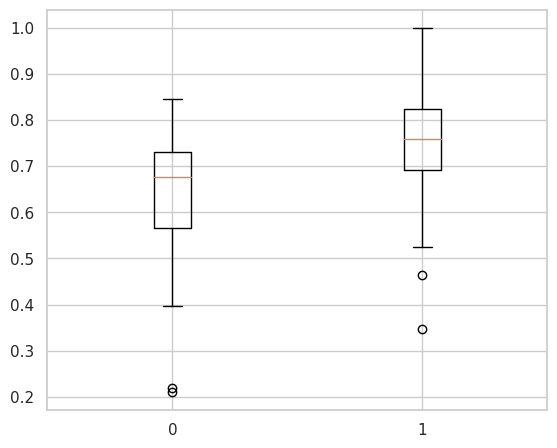

In [ ]:
make_box_plot(df_all_1,[0,1],'Sci Spacy')

<ipython-input-250-f4e4d5bf7a29>:11: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(marks)


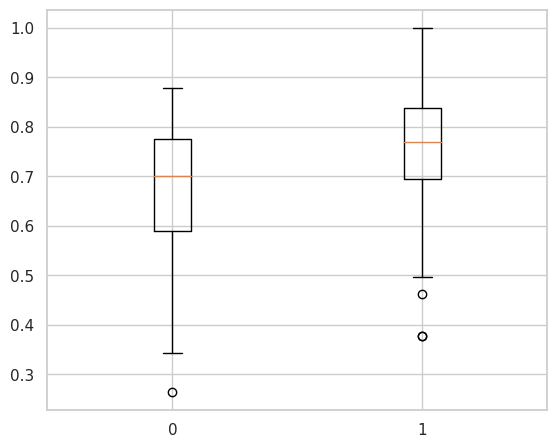

In [ ]:
make_box_plot(df_all_1,[0,1],'W2V')

<ipython-input-250-f4e4d5bf7a29>:11: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(marks)


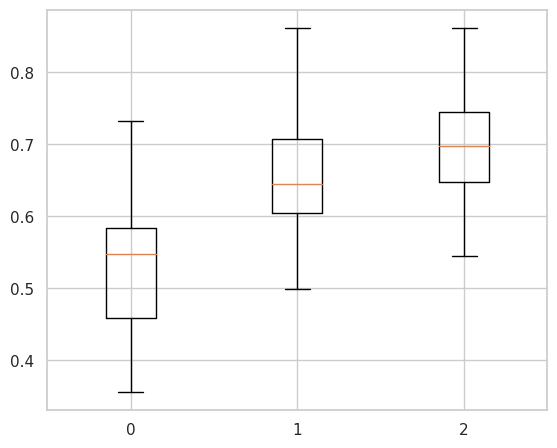

In [ ]:
make_box_plot(df_all_2,[0,1,2],'Sci Spacy')

<ipython-input-250-f4e4d5bf7a29>:11: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(marks)


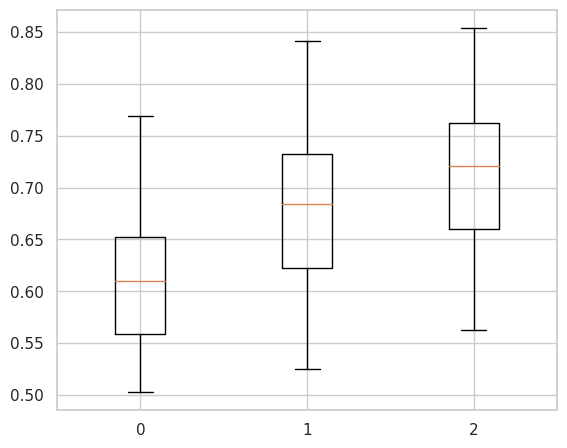

In [ ]:
make_box_plot(df_all_2,[0,1,2],'W2V')

### Assigning Marks

In [ ]:
def make_boundaries(grouped_df, model):
  means = list(grouped_df[model]['mean'])
  boundaries = []
  for i in range(len(means)-1):
    boundaries.append( (means[i] + means[i+1])/2 )
  return boundaries

In [ ]:
def assign_marks(x,boundaries,marks):
  c = 0
  for boundary in boundaries:
    if x < boundary:
      return marks[c]
    c += 1
  return marks[c]

def compute_accuracy(df,w2v_boundaries,ss_boundaries,marks):
  df['W2V_marks'] = df['W2V'].apply(lambda x: assign_marks(x,w2v_boundaries,marks))
  df['SS_marks'] = df['Sci Spacy'].apply(lambda x: assign_marks(x,ss_boundaries,marks))
  return df

In [ ]:
W2V_boundaries = make_boundaries(g2,'W2V')
SS_boundaries = make_boundaries(g2,'Sci Spacy')
df_all_2_acc = compute_accuracy(df_all_2,W2V_boundaries,SS_boundaries,[0,1,2])
SS_boundaries

[0.5918521275339177, 0.6753868706357604]

In [ ]:
W2V_boundaries = make_boundaries(g1,'W2V')
SS_boundaries = make_boundaries(g1,'Sci Spacy')
df_all_1_acc = compute_accuracy(df_all_1,W2V_boundaries,SS_boundaries,[0,1])

In [ ]:
print(W2V_boundaries)
print(SS_boundaries)

[0.7103606455236295]
[0.6922161862539036]


In [ ]:
df_all_2.head()

,Responses,Marks,Qs Num,W2V,Bert,Sci Spacy,Total_marks,W2V_marks,SS_marks
0,Force into distance from pivot,2,2,0.799269,0.914992,0.750081,2,2,2
1,The turning effect of the force,1,2,0.684517,0.856279,0.634150,2,1,1
2,It relates to turning effect of force,1,2,0.598909,0.979430,0.579472,2,0,0
3,It is Turning effect of force measure by multi...,1,2,0.841278,0.921117,0.830552,2,2,2
4,it is the work done in a perpendicular directi...,2,2,0.593455,0.922082,0.617978,2,0,1


In [ ]:
df_all_1.head()

,Responses,Marks,Qs Num,W2V,Bert,Sci Spacy,Total_marks,W2V_marks,SS_marks
0,Scalar quantities do not require direction to ...,1,1,0.812344,0.872339,0.815850,1,1,1
1,Scalar quantities are those which contain only...,1,1,0.710324,0.964885,0.749407,1,0,1
2,A scalar quantity only measures magnitude but ...,1,1,0.795771,0.971064,0.766679,1,1,1
3,Scalar quantities only have magnitude while ve...,1,1,0.787181,0.977260,0.796368,1,1,1
4,scalar is a physical quantity with a magnitude...,1,1,0.791670,0.986288,0.774442,1,1,1


In [ ]:
df_all_2.Marks.value_counts()

1    59
2    37
0    19
Name: Marks, dtype: int64

In [ ]:
df_all_1.Marks.value_counts()

1    80
0    36
Name: Marks, dtype: int64

In [ ]:
df_all_1.to_excel("Physics_scores_ms_from_model.xlsx")

### Making Confusion Matrix

In [ ]:
def make_cm(actual,pred):
    # Create original confusion matrix
    cm = confusion_matrix(actual, pred)

    sns.heatmap(cm, annot=True,fmt='.0f', cmap='Blues')

    plt.title('Confusion Matrix', fontsize = 18)
    plt.xlabel('Predicted', fontsize = 16)
    plt.ylabel('Actual', fontsize = 16)
    plt.show()

    # Calculate accuracy for each class
    accuracy_per_class = []
    tc, tt = 0, 0
    for i in range(len(cm[0])):
      correct = cm[i,i]
      tc += correct
      total = np.sum(cm[i,:])
      tt += total
      accuracy = correct / total
      accuracy_per_class.append(round(accuracy*100,2))

      # Print accuracy for each class
    for i, acc in enumerate(accuracy_per_class):
      print(f"Accuracy for {i} Marks: {accuracy_per_class[i]}%")

    print(f'\nOverall Accuracy: {round((tc/tt)*100,2)}%')


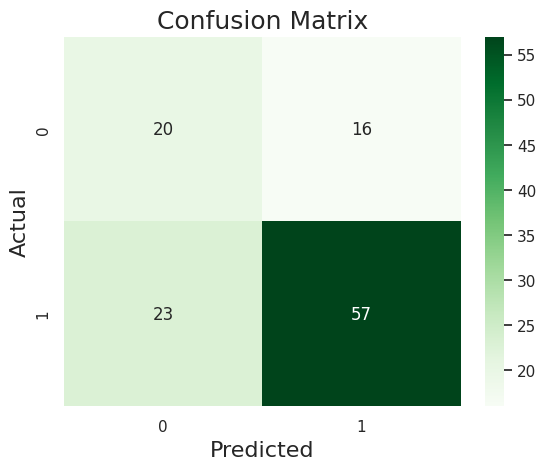

Accuracy for 0 Marks: 55.56%
Accuracy for 1 Marks: 71.25%

Overall Accuracy: 66.38%


In [ ]:
make_cm(df_all_1['Marks'],df_all_1['W2V_marks'])

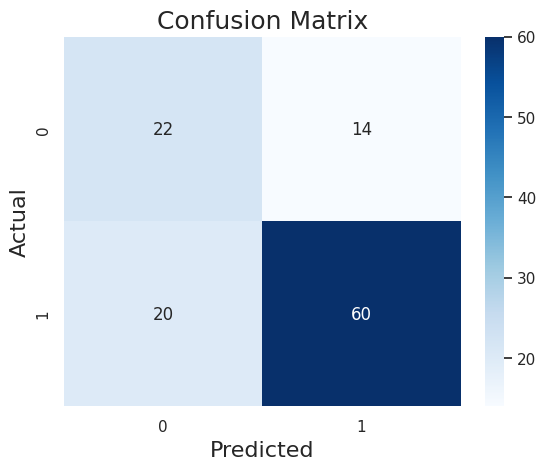

Accuracy for 0 Marks: 61.11%
Accuracy for 1 Marks: 75.0%

Overall Accuracy: 70.69%


In [ ]:
make_cm(df_all_1['Marks'],df_all_1['SS_marks'])

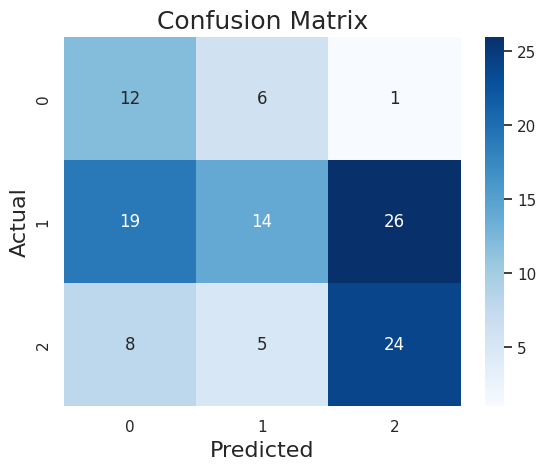

Accuracy for 0 Marks: 63.16%
Accuracy for 1 Marks: 23.73%
Accuracy for 2 Marks: 64.86%

Overall Accuracy: 43.48%


In [ ]:
make_cm(df_all_2['Marks'],df_all_2['W2V_marks'])

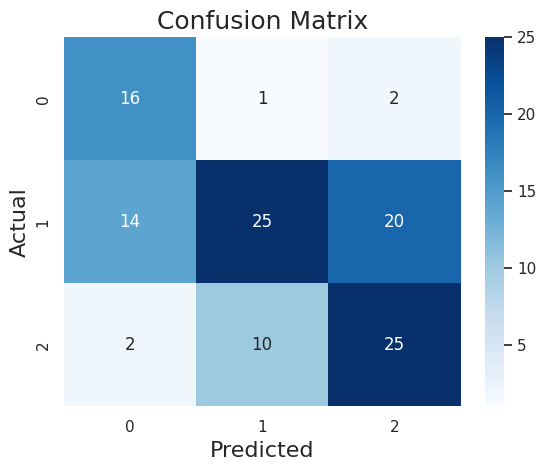

Accuracy for 0 Marks: 84.21%
Accuracy for 1 Marks: 42.37%
Accuracy for 2 Marks: 67.57%

Overall Accuracy: 57.39%


In [ ]:
make_cm(df_all_2['Marks'],df_all_2['SS_marks'])

### Concatenation Approach

In [ ]:
dfs = []
df_all = pd.DataFrame()
for i in range(n):
  sn = "Q" + str(i+1)
  df = pd.read_excel("/content/drive/MyDrive/Physics Answer Responses.xlsx",sheet_name=sn, header=0)
  df['Qs Num'] = i+1
  df['W2V'] = df['Responses'].apply(lambda x : get_similarity_concatenated(marking_scheme[i],x,nlp_w2v))
  #df['Bert'] = df['Responses'].apply(lambda x : get_similarity_bert(marking_scheme[i],x))

  df_all = df_all.append(df)
  dfs.append(df)


vector quantity has direction 0.7259483227215113
scalar quantity does not have direction 0.8123437755786901
0.8123437755786901

vector quantity has direction 0.6833912603630086
scalar quantity does not have direction 0.710324402338112
0.710324402338112

vector quantity has direction 0.7957705287275015
scalar quantity does not have direction 0.7336406316383656
0.7957705287275015

vector quantity has direction 0.7784826161811627
scalar quantity does not have direction 0.7871808489260517
0.7871808489260517

vector quantity has direction 0.7916698093298704
scalar quantity does not have direction 0.7673811027420592
0.7916698093298704

vector quantity has direction 0.790623879968303
scalar quantity does not have direction 0.8196277281595822
0.8196277281595822

vector quantity has direction 0.783789489160036
scalar quantity does not have direction 0.8555396242772534
0.8555396242772534

vector quantity has direction 0.7846305656311883
scalar quantity does not have direction 0.7240119734168594


<ipython-input-203-d52337234a0f>:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_all = df_all.append(df)


force multiplied by distance force multiplied by perpendicular distance 0.8087656885127905
force multiplied by distance force multiplied by perpendicular distance 0.6928669323412731
force multiplied by distance force multiplied by perpendicular distance 0.6057200164384215
force multiplied by distance force multiplied by perpendicular distance 0.8503992027660858
force multiplied by distance force multiplied by perpendicular distance 0.603745268237572
force multiplied by distance force multiplied by perpendicular distance 0.6286030139334388
force multiplied by distance force multiplied by perpendicular distance 0.771500361811512
force multiplied by distance force multiplied by perpendicular distance 0.7924761046865458
force multiplied by distance force multiplied by perpendicular distance 0.6472177169967498
force multiplied by distance force multiplied by perpendicular distance 0.5992034576612465
force multiplied by distance force multiplied by perpendicular distance 0.8601426309321826
f

<ipython-input-203-d52337234a0f>:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_all = df_all.append(df)


temperature of melting ice 0.7713383737515007
temperature of freezing water 0.8085213824272801
0.8085213824272801

temperature of melting ice 0.6871837232529787
temperature of freezing water 0.6854214444830006
0.6871837232529787

temperature of melting ice 0.7515131411095524
temperature of freezing water 0.7918594966260412
0.7918594966260412

temperature of melting ice 0.6901480514671607
temperature of freezing water 0.6980885238225133
0.6980885238225133

temperature of melting ice 0.8422423850273548
temperature of freezing water 0.7986114922245181
0.8422423850273548

temperature of melting ice 0.6036358315727112
temperature of freezing water 0.6157937142067241
0.6157937142067241

temperature of melting ice 0.5454497879303648
temperature of freezing water 0.544720989403416
0.5454497879303648

temperature of melting ice 0.8024968102166238
temperature of freezing water 0.8350596831305644
0.8350596831305644

temperature of melting ice 0.8008308860415586
temperature of freezing water 0.839

<ipython-input-203-d52337234a0f>:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_all = df_all.append(df)


speed remains the same wavelength decreases 0.7969407445013771
speed remains the same wavelength decreases 0.8718623931805932
speed remains the same wavelength decreases 0.7625958297202549
speed remains the same wavelength decreases 0.7995936305328247
speed remains the same wavelength decreases 0.783703508623771
speed remains the same wavelength decreases 0.8039876282349563
speed remains the same wavelength decreases 0.9007697719345794
speed remains the same wavelength decreases 0.9007697681313683
speed remains the same wavelength decreases 0.8849961626829433
speed remains the same wavelength decreases 0.787245012981703
speed remains the same wavelength decreases 0.8998321907646287
speed remains the same wavelength decreases 0.8068290814861294


<ipython-input-203-d52337234a0f>:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_all = df_all.append(df)


Force per unit area 0.5299949072272345
0.5299949072272345

Force per unit area 0.977189771544881
0.977189771544881

Force per unit area 0.9514604114297539
0.9514604114297539

Force per unit area 0.7617343339909757
0.7617343339909757

Force per unit area 0.40366519727260597
0.40366519727260597

Force per unit area 0.54635018208659
0.54635018208659

Force per unit area 1.0
1.0



<ipython-input-203-d52337234a0f>:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_all = df_all.append(df)


Molecules have more kinetic energy Hits sides harder 0.7087339229709672
Molecules have more kinetic energy Hits sides with more force 0.7122235466630646
Molecules have more kinetic energy Hits sides more often 0.6848788156669717
Molecules have more kinetic energy Hits sides more frequently 0.6796106060905688
Molecules have more kinetic energy Creates larger pressure 0.7427434473498273
Molecules have more speed Hits sides harder 0.6187740538272035
Molecules have more speed Hits sides with more force 0.6458241048241581
Molecules have more speed Hits sides more often 0.6073506811172413
Molecules have more speed Hits sides more frequently 0.5956471819526078
Molecules have more speed Creates larger pressure 0.6654067500711932
Molecules have more velocity Hits sides harder 0.6171086593068833
Molecules have more velocity Hits sides with more force 0.6357966489543281
Molecules have more velocity Hits sides more often 0.6022347139825948
Molecules have more velocity Hits sides more frequently 0.

<ipython-input-203-d52337234a0f>:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_all = df_all.append(df)


Radiation when there is no source 0.79695187585733
Naturally occurring radiation 0.5050302365563017
Radiation that is always present 0.9095452605704784
0.9095452605704784

Radiation when there is no source 0.6397943201433188
Naturally occurring radiation 0.6720639921220738
Radiation that is always present 0.7289530623084106
0.7289530623084106

Radiation when there is no source 0.71868216426196
Naturally occurring radiation 0.7269042595417632
Radiation that is always present 0.7846695692169346
0.7846695692169346



<ipython-input-203-d52337234a0f>:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_all = df_all.append(df)


(average) time (taken for) Count rate to halve 0.7605809210007642
(average) time (taken for) number of nuclei to halve 0.8476970588918906
(average) time (taken for) number of atoms to halve 0.823212881029317
(average) time (taken for) Count rate to halve 0.7908442189805039
(average) time (taken for) number of nuclei to halve 0.8568826171613568
(average) time (taken for) number of atoms to halve 0.8458028867224449
(average) time (taken for) Count rate to halve 0.7188918877933653
(average) time (taken for) number of nuclei to halve 0.79043944209237
(average) time (taken for) number of atoms to halve 0.765384805813066
(average) time (taken for) Count rate to halve 0.5968399848215724
(average) time (taken for) number of nuclei to halve 0.6995378633543647
(average) time (taken for) number of atoms to halve 0.699923456258021
(average) time (taken for) Count rate to halve 0.7772345569843379
(average) time (taken for) number of nuclei to halve 0.7669023169357394
(average) time (taken for) numb

<ipython-input-203-d52337234a0f>:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_all = df_all.append(df)
<ipython-input-203-d52337234a0f>:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_all = df_all.append(df)


 0.31183939823518003
Less heat lost 0.41556770001777416
Less energy lost 0.39212664897982397
0.597224269632117

Provides smaller (internal) resistance 0.3526127659051377
Lasts longer 0.31374481387530095
Less lost voltage 0.3249637249786308
One (cell) fails others work 0.6175736257620627
Less heat lost 0.2687533324080665
Less energy lost 0.3460949017261741
0.6175736257620627

Provides smaller (internal) resistance 0.5390824320966366
Lasts longer 0.2510811083843164
Less lost voltage 0.5915072791519319
One (cell) fails others work 0.47525168031637355
Less heat lost 0.4441827358411142
Less energy lost 0.5467240828181341
0.5915072791519319

Provides smaller (internal) resistance 0.4562492314634646
Lasts longer 0.2409664706567773
Less lost voltage 0.6611603073639157
One (cell) fails others work 0.3212312158979429
Less heat lost 0.34682645258100675
Less energy lost 0.3567560823075066
0.6611603073639157

Current proportional to voltage Provided temperature unchanged 0.7128954457064393
Current 

<ipython-input-203-d52337234a0f>:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_all = df_all.append(df)


no costs for water or energy supply 0.7472654523740447
Coal produces smoke or dust or harmful gases or Carbondixoide hence less pollution 0.620559559339418
No need to transport coal or renewable 0.6869024076861139
Rapid response to power demand 0.554698753123825
Less heat produced or more effecient 0.6305256722860368
0.7472654523740447

no costs for water or energy supply 0.6458672031283456
Coal produces smoke or dust or harmful gases or Carbondixoide hence less pollution 0.5675560441261699
No need to transport coal or renewable 0.6135092447572079
Rapid response to power demand 0.44761645463557465
Less heat produced or more effecient 0.5641322124359522
0.6458672031283456

no costs for water or energy supply 0.46211130490225644
Coal produces smoke or dust or harmful gases or Carbondixoide hence less pollution 0.42353280066153454
No need to transport coal or renewable 0.36271890828026876
Rapid response to power demand 0.33068252568211315
Less heat produced or more effecient 0.42746333211

<ipython-input-203-d52337234a0f>:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_all = df_all.append(df)


molecules move faster more molecules have energy 0.7404473135629309
molecules move faster Molecules have speed to break bonds 0.7596391363533358
molecules move faster Molecules overcome forces 0.701641143257353
Molecules have higher energy more molecules have energy 0.7012665559923853
Molecules have higher energy Molecules have speed to break bonds 0.7708701314422252
Molecules have higher energy Molecules overcome forces 0.7423279029318616
molecules move faster more molecules have energy 0.890125409798686
molecules move faster Molecules have speed to break bonds 0.8210835097044342
molecules move faster Molecules overcome forces 0.7477284368376628
Molecules have higher energy more molecules have energy 0.8680571353270496
Molecules have higher energy Molecules have speed to break bonds 0.8711006063128729
Molecules have higher energy Molecules overcome forces 0.8422709481539484
molecules move faster more molecules have energy 0.7246153494112929
molecules move faster Molecules have speed t

<ipython-input-203-d52337234a0f>:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_all = df_all.append(df)


molecules hit each other 0.6576675164646192
Molecules pass vibration on 0.6398661311009708
Free electrons move through metal and hit molecules 0.7004340681878205
0.7004340681878205

molecules hit each other 0.7037711692655154
Molecules pass vibration on 0.6775667685893187
Free electrons move through metal and hit molecules 0.7389746510888252
0.7389746510888252

molecules hit each other 0.5998565787107758
Molecules pass vibration on 0.6100301229448595
Free electrons move through metal and hit molecules 0.7120140801522703
0.7120140801522703

molecules hit each other 0.6432894074644849
Molecules pass vibration on 0.6066428194342466
Free electrons move through metal and hit molecules 0.676822022984826
0.676822022984826

molecules hit each other 0.719407959749956
Molecules pass vibration on 0.6861434431504987
Free electrons move through metal and hit molecules 0.7171113729057444
0.719407959749956

molecules hit each other 0.6472688487261936
Molecules pass vibration on 0.6063988181258002
Fre

<ipython-input-203-d52337234a0f>:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_all = df_all.append(df)


fiberglass or air is a bad conductor or insulator fiberglass traps air 0.6860616619518917
fiberglass or air is a bad conductor or insulator Prevents convection 0.7162532601096697
Reduces heat flow fiberglass traps air 0.6246738418175737
Reduces heat flow Prevents convection 0.6222190074834101
fiberglass or air is a bad conductor or insulator fiberglass traps air 0.7680898826158772
fiberglass or air is a bad conductor or insulator Prevents convection 0.7704389980752564
Reduces heat flow fiberglass traps air 0.5707726239566752
Reduces heat flow Prevents convection 0.4951853864064109
fiberglass or air is a bad conductor or insulator fiberglass traps air 0.690690812528976
fiberglass or air is a bad conductor or insulator Prevents convection 0.7034293984773564
Reduces heat flow fiberglass traps air 0.5875604878735896
Reduces heat flow Prevents convection 0.548860600507711
fiberglass or air is a bad conductor or insulator fiberglass traps air 0.7407456840661883
fiberglass or air is a bad con

<ipython-input-203-d52337234a0f>:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_all = df_all.append(df)


number of complete waves or cycles 0.7866103156023531
Oscillations per unit time or second 0.5814373114763395
0.7866103156023531

number of complete waves or cycles 0.7715865367842656
Oscillations per unit time or second 0.8993634039983849
0.8993634039983849

number of complete waves or cycles 0.8857054930335843
Oscillations per unit time or second 0.7725643473830618
0.8857054930335843

number of complete waves or cycles 0.6779584957443886
Oscillations per unit time or second 0.900034423316354
0.900034423316354

number of complete waves or cycles 0.8358542812807757
Oscillations per unit time or second 0.7581711065204946
0.8358542812807757

number of complete waves or cycles 0.7867435695158507
Oscillations per unit time or second 0.87016056148354
0.87016056148354

number of complete waves or cycles 0.5792959613368315
Oscillations per unit time or second 0.7380391637818821
0.7380391637818821

number of complete waves or cycles 0.7997741117327654
Oscillations per unit time or second 0.702

<ipython-input-203-d52337234a0f>:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_all = df_all.append(df)


Wavelength decreases travels a shorter distance in the same time 0.7618697109088624
Wavelength decreases Frequency stays the same 0.7605079689517567
Wavelength decreases travels a shorter distance in the same time 0.7914095789265656
Wavelength decreases Frequency stays the same 0.7930316684582793
Wavelength decreases travels a shorter distance in the same time 0.8078372212051775
Wavelength decreases Frequency stays the same 0.7862263174048018
Wavelength decreases travels a shorter distance in the same time 0.6809185221181464
Wavelength decreases Frequency stays the same 0.7605546353810582
Wavelength decreases travels a shorter distance in the same time 0.7884197086286834
Wavelength decreases Frequency stays the same 0.739421323545448
Wavelength decreases travels a shorter distance in the same time 0.7800076417551552
Wavelength decreases Frequency stays the same 0.8120707689066528
Wavelength decreases travels a shorter distance in the same time 0.8059047149402044
Wavelength decreases Fr

<ipython-input-203-d52337234a0f>:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_all = df_all.append(df)


0.816681621403542
Water molecules move within the liquid 0.8333002055680474
Air molecules far apart 0.7803648666560095
Air molecules further apart 0.7698214622744326
Air molecules move individually 0.7601683147365854
Air molecules move throughout the container 0.8326683208120167
0.8333002055680474

Water molecules close 0.6798181600904297
Water molecules closer 0.6356863683982901
Water molecules move in clusters 0.8224062579000581
Water molecules move within the liquid 0.8055293220842884
Air molecules far apart 0.6208225145563209
Air molecules further apart 0.6274749925595542
Air molecules move individually 0.6288593263054624
Air molecules move throughout the container 0.7664506595692665
0.8224062579000581

Water molecules close 0.809887210677564
Water molecules closer 0.7996934222018925
Water molecules move in clusters 0.898136725750954
Water molecules move within the liquid 0.8927216991702276
Air molecules far apart 0.7823944465362617
Air molecules further apart 0.8251574363574391
Ai

<ipython-input-203-d52337234a0f>:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_all = df_all.append(df)


more water above larger weight of water above 0.6737367545273144
more force from water larger weight of water above 0.7186290396773842
more atoms above larger weight of water above 0.7265499728521564
more molecules above larger weight of water above 0.7408070401391426
more water above larger weight of water above 0.802849868036785
more force from water larger weight of water above 0.8483615036722126
more atoms above larger weight of water above 0.7828791597503053
more molecules above larger weight of water above 0.8000551446265691
more water above larger weight of water above 0.6870060448987709
more force from water larger weight of water above 0.6962866593007017
more atoms above larger weight of water above 0.7142129924267601
more molecules above larger weight of water above 0.7287162161624772
more water above larger weight of water above 0.6867743754147444
more force from water larger weight of water above 0.7860652661076233
more atoms above larger weight of water above 0.69156133852

<ipython-input-203-d52337234a0f>:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_all = df_all.append(df)


measures small changes in temperature 0.7844018227896631
measures smaller change in temperature 0.7390901096741607
Small range for same distance 0.5944143837643288
Smaller range for same distance 0.5497005889576467
Large expansion for same temperature rise 0.7761318432086909
Larger expansion for same temperature rise 0.7082947214460289
0.7844018227896631

measures small changes in temperature 0.7849230052823114
measures smaller change in temperature 0.8111715205907325
Small range for same distance 0.5338801739395896
Smaller range for same distance 0.5669379240161884
Large expansion for same temperature rise 0.6804580916456827
Larger expansion for same temperature rise 0.702993364932308
0.8111715205907325

measures small changes in temperature 0.7829180279469998
measures smaller change in temperature 0.7411657616665737
Small range for same distance 0.4601699425093589
Smaller range for same distance 0.4310077834959691
Large expansion for same temperature rise 0.7064329728005521
Larger ex

<ipython-input-203-d52337234a0f>:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_all = df_all.append(df)


mercury contracts mercury breaks 0.30541481757957273
mercury contracts Liquid breaks 0.5582089788256271
mercury contracts Thread breaks 0.30760210861630444
mercury contracts mercury breaks at the constriction 0.6410000771096593
mercury contracts Liquid breaks at the constriction 0.7376280609529561
mercury contracts Thread breaks at the constriction 0.6379774978147739
mercury contracts Constriction stops the mercury falling back 0.6345544437179425
Liquid contracts mercury breaks 0.5582089811165997
Liquid contracts Liquid breaks 0.6303760552719163
Liquid contracts Thread breaks 0.6060162487157529
Liquid contracts mercury breaks at the constriction 0.7376280612099939
Liquid contracts Liquid breaks at the constriction 0.7699434508212958
Liquid contracts Thread breaks at the constriction 0.7420279743446364
Liquid contracts Constriction stops the mercury falling back 0.7241219741675775
mercury contracts mercury breaks 0.23582767024051973
mercury contracts Liquid breaks 0.3513476318419879
mer

<ipython-input-203-d52337234a0f>:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_all = df_all.append(df)


time between emission varies 0.49561069534329716
Time between emissions unpredictable 0.3565181448324513
Different readings 0.3709319905826562
Different readings when repeated for same time 0.5283491515121472
0.5283491515121472

time between emission varies 0.37473415621704814
Time between emissions unpredictable 0.32325157514889197
Different readings 0.12198518749398939
Different readings when repeated for same time 0.37829174281471195
0.37829174281471195

time between emission varies 0.521970545233779
Time between emissions unpredictable 0.4546376855055421
Different readings 0.5777103753099273
Different readings when repeated for same time 0.6907319709818911
0.6907319709818911

time between emission varies 0.6958955900563892
Time between emissions unpredictable 0.6377547347719206
Different readings 0.38777588445562516
Different readings when repeated for same time 0.740888543894941
0.740888543894941

time between emission varies 0.5437220474975845
Time between emissions unpredictable

<ipython-input-203-d52337234a0f>:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_all = df_all.append(df)


 0.8271647144104642
measure count with no source Subtract from measured count 0.8055292485703286
measure count with no source Subtract from count rate 0.8177060838768347
measure count with no source Subtract from count 0.7895971225423674
Measure count rate with no source subtract from measured count rate 0.7960296689240927
Measure count rate with no source Subtract from measured count 0.827164678704455
Measure count rate with no source Subtract from count rate 0.7815644001581413
Measure count rate with no source Subtract from count 0.8177061292864582
measure count with no source subtract from measured count rate 0.8358607392141856
measure count with no source Subtract from measured count 0.7282449770280092
measure count with no source Subtract from count rate 0.8172586837207654
measure count with no source Subtract from count 0.6912482113478342
Measure count rate with no source subtract from measured count rate 0.8709981870784619
Measure count rate with no source Subtract from measured

<ipython-input-203-d52337234a0f>:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_all = df_all.append(df)


In [ ]:
df_all.head()

,Responses,Marks,Qs Num,W2V
0,Scalar quantities do not require direction to ...,1,1,0.812344
1,Scalar quantities are those which contain only...,1,1,0.710324
2,A scalar quantity only measures magnitude but ...,1,1,0.795771
3,Scalar quantities only have magnitude while ve...,1,1,0.787181
4,scalar is a physical quantity with a magnitude...,1,1,0.791670


In [ ]:
# Load the en_core_sci_lg model
#nlp_ss = spacy.load("en_core_sci_lg")

# define a function to apply to each row
def similarity_for_spacy(row):
    ans = row['Responses']
    ms_index = row['Qs Num'] - 1
    x = get_similarity_concatenated(marking_scheme[ms_index],ans,nlp_ss)
    return x

# apply the function to each row of the dataframe
df_all['Sci Spacy'] = df_all.apply(similarity_for_spacy, axis=1)

vector quantity has direction 0.6993764986550974
scalar quantity does not have direction 0.8158495624851321
0.8158495624851321

vector quantity has direction 0.7221789318725124
scalar quantity does not have direction 0.7494069193698071
0.7494069193698071

vector quantity has direction 0.7564336946497717
scalar quantity does not have direction 0.7666787228082329
0.7666787228082329

vector quantity has direction 0.7863804026604223
scalar quantity does not have direction 0.7963678199161702
0.7963678199161702

vector quantity has direction 0.7744422010554035
scalar quantity does not have direction 0.7396950433669575
0.7744422010554035

vector quantity has direction 0.8075091124999155
scalar quantity does not have direction 0.8458592706630773
0.8458592706630773

vector quantity has direction 0.8193142664668351
scalar quantity does not have direction 0.8471179090757013
0.8471179090757013

vector quantity has direction 0.7355176492112744
scalar quantity does not have direction 0.7213547708092

In [ ]:
df_all

,Responses,Marks,Qs Num,W2V,Sci Spacy
0,Scalar quantities do not require direction to ...,1,1,0.812344,0.815850
1,Scalar quantities are those which contain only...,1,1,0.710324,0.749407
2,A scalar quantity only measures magnitude but ...,1,1,0.795771,0.766679
3,Scalar quantities only have magnitude while ve...,1,1,0.787181,0.796368
4,scalar is a physical quantity with a magnitude...,1,1,0.791670,0.774442
...,...,...,...,...,...
3,The background radiation is measured by keepin...,2,22,0.823126,0.780495
4,you count the rate without the source and subt...,2,22,0.827165,0.835447
5,The background count rate is measured and subt...,2,22,0.870998,0.918682
6,A cover for the gm tube,0,22,0.592226,0.450251


In [ ]:
df_all['Total_marks'] = df_all['Qs Num'].apply(lambda x: assign_total_marks(x))
df_all_1 = df_all[df_all['Total_marks']==1].reset_index(drop=True)
df_all_2 = df_all[df_all['Total_marks']==2].reset_index(drop=True)

In [ ]:
g1, g2 = min_max_mean(df_all_1, df_all_2,bert = False)

In [ ]:
g1

W2V                     Sci Spacy                    
           mean       min       max      mean       min       max
Marks                                                            
0      0.661604  0.265362  0.879551  0.626304  0.211006  0.845617
1      0.754424  0.378109  1.000000  0.753368  0.347740  1.000000

In [ ]:
g2

W2V                     Sci Spacy                    
           mean       min       max      mean       min       max
Marks                                                            
0      0.746723  0.592226  0.899832  0.644258  0.450251  0.891128
1      0.764722  0.599203  0.900770  0.741624  0.559113  0.879710
2      0.793129  0.603745  0.890125  0.788893  0.627991  0.918682

<ipython-input-173-f4e4d5bf7a29>:11: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(marks)


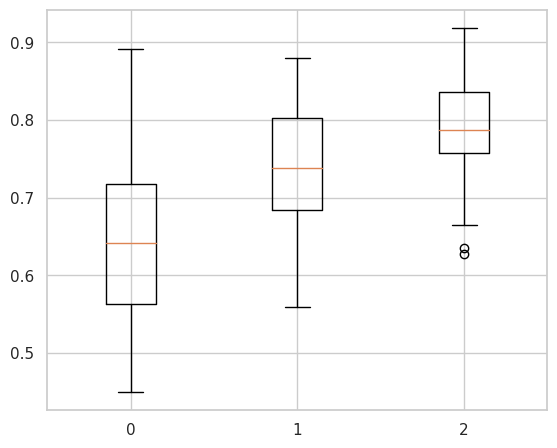

In [ ]:
make_box_plot(df_all_2,[0,1,2],'Sci Spacy')

<ipython-input-173-f4e4d5bf7a29>:11: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(marks)


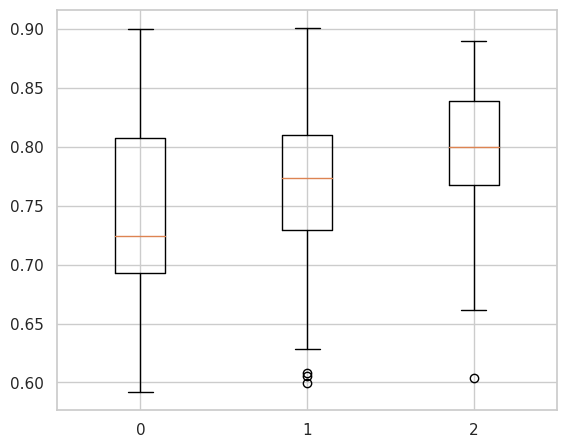

In [ ]:
make_box_plot(df_all_2,[0,1,2],'W2V')

In [ ]:
df_all_2.head()

,Responses,Marks,Qs Num,W2V,Sci Spacy,Total_marks
0,Force into distance from pivot,2,2,0.808766,0.765669,2
1,The turning effect of the force,1,2,0.692867,0.643763,2
2,It relates to turning effect of force,1,2,0.605720,0.588972,2
3,It is Turning effect of force measure by multi...,1,2,0.850399,0.841124,2
4,it is the work done in a perpendicular directi...,2,2,0.603745,0.635028,2


In [ ]:
W2V_boundaries = make_boundaries(g2,'W2V')
SS_boundaries = make_boundaries(g2,'Sci Spacy')
df_all_2_acc = compute_accuracy(df_all_2,W2V_boundaries,SS_boundaries,[0,1,2])
SS_boundaries

[0.6929410091040682, 0.7652586876699801]

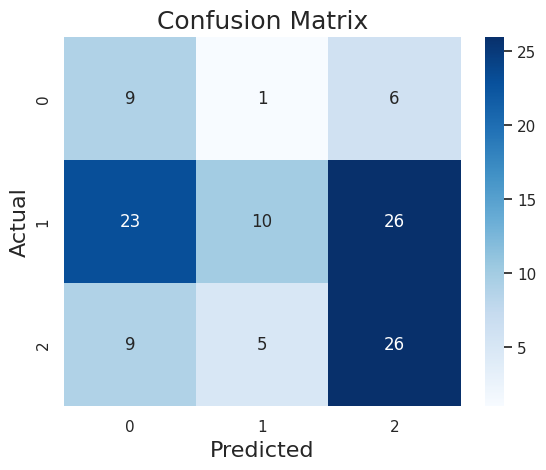

Accuracy for 0 Marks: 56.25%
Accuracy for 1 Marks: 16.95%
Accuracy for 2 Marks: 65.0%

Overall Accuracy: 39.13%


In [ ]:
make_cm(df_all_2_acc['Marks'],df_all_2_acc['W2V_marks'])

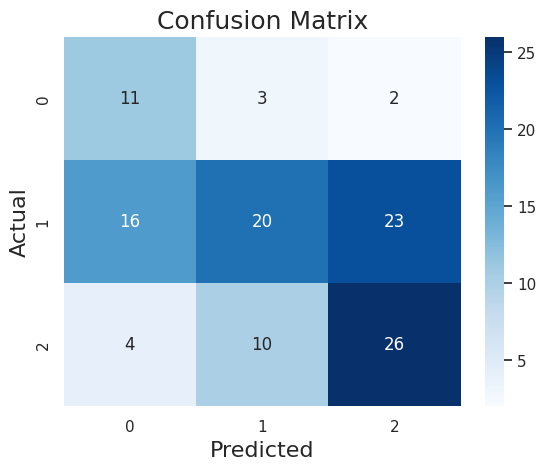

Accuracy for 0 Marks: 68.75%
Accuracy for 1 Marks: 33.9%
Accuracy for 2 Marks: 65.0%

Overall Accuracy: 49.57%


In [ ]:
make_cm(df_all_2_acc['Marks'],df_all_2_acc['SS_marks'])

### Binary Approach

In [ ]:
dfs = []
df_all = pd.DataFrame()
for i in range(n):
  sn = "Q" + str(i+1)
  df = pd.read_excel("/content/drive/MyDrive/Physics Answer Responses.xlsx",sheet_name=sn, header=0)
  df['Qs Num'] = i+1
  df['W2V'] = df['Responses'].apply(lambda x : get_similarity_binary(marking_scheme[i],x,nlp_w2v))
  #df['Bert'] = df['Responses'].apply(lambda x : get_similarity_bert(marking_scheme[i],x))

  df_all = df_all.append(df)
  dfs.append(df)


vector quantity has direction 0.7259483227215113
scalar quantity does not have direction 0.8123437755786901
0.8123437755786901

vector quantity has direction 0.6833912603630086
scalar quantity does not have direction 0.710324402338112
0.710324402338112

vector quantity has direction 0.7957705287275015
scalar quantity does not have direction 0.7336406316383656
0.7957705287275015

vector quantity has direction 0.7784826161811627
scalar quantity does not have direction 0.7871808489260517
0.7871808489260517

vector quantity has direction 0.7916698093298704
scalar quantity does not have direction 0.7673811027420592
0.7916698093298704

vector quantity has direction 0.790623879968303
scalar quantity does not have direction 0.8196277281595822
0.8196277281595822

vector quantity has direction 0.783789489160036
scalar quantity does not have direction 0.8555396242772534
0.8555396242772534

vector quantity has direction 0.7846305656311883
scalar quantity does not have direction 0.7240119734168594


<ipython-input-219-3a5098e2cb3a>:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_all = df_all.append(df)
<ipython-input-219-3a5098e2cb3a>:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_all = df_all.append(df)


 0.7496115524818022
0.7496115524818022

temperature of melting ice 0.7713383737515007
temperature of freezing water 0.8085213824272801
0.8085213824272801

temperature of melting ice 0.6871837232529787
temperature of freezing water 0.6854214444830006
0.6871837232529787

temperature of melting ice 0.7515131411095524
temperature of freezing water 0.7918594966260412
0.7918594966260412

temperature of melting ice 0.6901480514671607
temperature of freezing water 0.6980885238225133
0.6980885238225133

temperature of melting ice 0.8422423850273548
temperature of freezing water 0.7986114922245181
0.8422423850273548

temperature of melting ice 0.6036358315727112
temperature of freezing water 0.6157937142067241
0.6157937142067241

temperature of melting ice 0.5454497879303648
temperature of freezing water 0.544720989403416
0.5454497879303648

temperature of melting ice 0.8024968102166238
temperature of freezing water 0.8350596831305644
0.8350596831305644

temperature of melting ice 0.800830886041

<ipython-input-219-3a5098e2cb3a>:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_all = df_all.append(df)
<ipython-input-219-3a5098e2cb3a>:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_all = df_all.append(df)


 0.7506566181296235
0.7506566181296235
wavelength decreases 0.8291619244722224
0.8291619244722224

speed remains the same 0.7506566149602171
0.7506566149602171
wavelength decreases 0.8291619209713526
0.8291619209713526

speed remains the same 0.7100303072568959
0.7100303072568959
wavelength decreases 0.8644451755173566
0.8644451755173566

speed remains the same 0.6262520699128692
0.6262520699128692
wavelength decreases 0.7786642022777499
0.7786642022777499

speed remains the same 0.7990442889019423
0.7990442889019423
wavelength decreases 0.7391930206639876
0.7391930206639876

speed remains the same 0.669424074906056
0.669424074906056
wavelength decreases 0.7480300167651394
0.7480300167651394

Force per unit area 0.5299949072272345
0.5299949072272345

Force per unit area 0.977189771544881
0.977189771544881

Force per unit area 0.9514604114297539
0.9514604114297539

Force per unit area 0.7617343339909757
0.7617343339909757

Force per unit area 0.40366519727260597
0.40366519727260597

For

<ipython-input-219-3a5098e2cb3a>:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_all = df_all.append(df)


Molecules have more kinetic energy 0.6804059561992553
Molecules have more speed 0.6013656558962339
Molecules have more velocity 0.5981281156293848
0.6804059561992553
Hits sides harder 0.28962113830481
Hits sides with more force 0.5267116697599121
Hits sides more often 0.45777559535747886
Hits sides more frequently 0.40955028799118676
Creates larger pressure 0.5492248421558865
0.5492248421558865

Molecules have more kinetic energy 0.7069578944324765
Molecules have more speed 0.5831632051445431
Molecules have more velocity 0.5857827997226859
0.7069578944324765
Hits sides harder 0.22900716993985382
Hits sides with more force 0.5469704515135717
Hits sides more often 0.5143321884262286
Hits sides more frequently 0.4334862052759019
Creates larger pressure 0.533440292097033
0.5469704515135717

Molecules have more kinetic energy 0.620320149829856
Molecules have more speed 0.5739781345887183
Molecules have more velocity 0.5670579711832411
0.620320149829856
Hits sides harder 0.3275973564756159
H

<ipython-input-219-3a5098e2cb3a>:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_all = df_all.append(df)


Radiation when there is no source 0.79695187585733
Naturally occurring radiation 0.5050302365563017
Radiation that is always present 0.9095452605704784
0.9095452605704784

Radiation when there is no source 0.6397943201433188
Naturally occurring radiation 0.6720639921220738
Radiation that is always present 0.7289530623084106
0.7289530623084106

Radiation when there is no source 0.71868216426196
Naturally occurring radiation 0.7269042595417632
Radiation that is always present 0.7846695692169346
0.7846695692169346



<ipython-input-219-3a5098e2cb3a>:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_all = df_all.append(df)


(average) time (taken for) 0.7090777105586894
0.7090777105586894
Count rate to halve 0.5726648822458498
number of nuclei to halve 0.7294271448533657
number of atoms to halve 0.6669804823732756
0.7294271448533657

(average) time (taken for) 0.7159514916958314
0.7159514916958314
Count rate to halve 0.6250597268084839
number of nuclei to halve 0.7380799045263514
number of atoms to halve 0.6966472385200293
0.7380799045263514

(average) time (taken for) 0.6771913211736624
0.6771913211736624
Count rate to halve 0.5315917666824086
number of nuclei to halve 0.6653548187911585
number of atoms to halve 0.6039407395664232
0.6653548187911585

(average) time (taken for) 0.47658346518454203
0.47658346518454203
Count rate to halve 0.5601555383349842
number of nuclei to halve 0.7023306054166725
number of atoms to halve 0.6811435370931554
0.7023306054166725

(average) time (taken for) 0.6642197092719389
0.6642197092719389
Count rate to halve 0.6689841540806788
number of nuclei to halve 0.63889049132530

<ipython-input-219-3a5098e2cb3a>:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_all = df_all.append(df)


Provides smaller (internal) resistance 0.5857678441392008
Lasts longer 0.2753296360772769
Less lost voltage 0.545562533652147
One (cell) fails others work 0.5140789898307805
Less heat lost 0.35693296101164734
Less energy lost 0.4218711811790387
0.5857678441392008

Provides smaller (internal) resistance 0.5065675729320506
Lasts longer 0.3570817797874011
Less lost voltage 0.4812657015517362
One (cell) fails others work 0.4112352333268046
Less heat lost 0.46993339054916006
Less energy lost 0.5003046468665768
0.5065675729320506

Provides smaller (internal) resistance 0.47966878518817374
Lasts longer 0.2505629577327851
Less lost voltage 0.597224269632117
One (cell) fails others work 0.31183939823518003
Less heat lost 0.41556770001777416
Less energy lost 0.39212664897982397
0.597224269632117

Provides smaller (internal) resistance 0.3526127659051377
Lasts longer 0.31374481387530095
Less lost voltage 0.3249637249786308
One (cell) fails others work 0.6175736257620627
Less heat lost 0.268753332

<ipython-input-219-3a5098e2cb3a>:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_all = df_all.append(df)


Current proportional to voltage 0.7300059659254318
0.7300059659254318
Provided temperature unchanged 0.3107871137016568
Provided physical conditions unchanged 0.3904614077925076
0.3904614077925076

Current proportional to voltage 0.8464908272458918
0.8464908272458918
Provided temperature unchanged 0.36585012394774996
Provided physical conditions unchanged 0.30960239448325266
0.36585012394774996

Current proportional to voltage 0.6942108464959338
0.6942108464959338
Provided temperature unchanged 0.34658488234341395
Provided physical conditions unchanged 0.1273416799347032
0.34658488234341395

Current proportional to voltage 0.8151626080624104
0.8151626080624104
Provided temperature unchanged 0.3432567780689921
Provided physical conditions unchanged 0.404084149308462
0.404084149308462

Current proportional to voltage 0.7853421289771406
0.7853421289771406
Provided temperature unchanged 0.3685888357972352
Provided physical conditions unchanged 0.3720985521412405
0.3720985521412405

Current

<ipython-input-219-3a5098e2cb3a>:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_all = df_all.append(df)


no costs for water or energy supply 0.7472654523740447
Coal produces smoke or dust or harmful gases or Carbondixoide hence less pollution 0.620559559339418
No need to transport coal or renewable 0.6869024076861139
Rapid response to power demand 0.554698753123825
Less heat produced or more effecient 0.6305256722860368
0.7472654523740447

no costs for water or energy supply 0.6458672031283456
Coal produces smoke or dust or harmful gases or Carbondixoide hence less pollution 0.5675560441261699
No need to transport coal or renewable 0.6135092447572079
Rapid response to power demand 0.44761645463557465
Less heat produced or more effecient 0.5641322124359522
0.6458672031283456

no costs for water or energy supply 0.46211130490225644
Coal produces smoke or dust or harmful gases or Carbondixoide hence less pollution 0.42353280066153454
No need to transport coal or renewable 0.36271890828026876
Rapid response to power demand 0.33068252568211315
Less heat produced or more effecient 0.42746333211

<ipython-input-219-3a5098e2cb3a>:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_all = df_all.append(df)


molecules move faster 0.6689245547908992
Molecules have higher energy 0.6930767236427686
0.6930767236427686
more molecules have energy 0.6865469872729552
Molecules have speed to break bonds 0.7483601686796647
Molecules overcome forces 0.5769250666108253
0.7483601686796647

molecules move faster 0.7390618122720288
Molecules have higher energy 0.8345330681940286
0.8345330681940286
more molecules have energy 0.8728395734716017
Molecules have speed to break bonds 0.7978009528279355
Molecules overcome forces 0.5878713751857502
0.8728395734716017

molecules move faster 0.661261537987255
Molecules have higher energy 0.7006737999168441
0.7006737999168441
more molecules have energy 0.6670205639246082
Molecules have speed to break bonds 0.6860901753762724
Molecules overcome forces 0.46794586331726845
0.6860901753762724

molecules move faster 0.8642277412963926
Molecules have higher energy 0.6629748675571034
0.8642277412963926
more molecules have energy 0.6788765189874568
Molecules have speed to 

<ipython-input-219-3a5098e2cb3a>:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_all = df_all.append(df)


molecules hit each other 0.6576675164646192
Molecules pass vibration on 0.6398661311009708
Free electrons move through metal and hit molecules 0.7004340681878205
0.7004340681878205

molecules hit each other 0.7037711692655154
Molecules pass vibration on 0.6775667685893187
Free electrons move through metal and hit molecules 0.7389746510888252
0.7389746510888252

molecules hit each other 0.5998565787107758
Molecules pass vibration on 0.6100301229448595
Free electrons move through metal and hit molecules 0.7120140801522703
0.7120140801522703

molecules hit each other 0.6432894074644849
Molecules pass vibration on 0.6066428194342466
Free electrons move through metal and hit molecules 0.676822022984826
0.676822022984826

molecules hit each other 0.719407959749956
Molecules pass vibration on 0.6861434431504987
Free electrons move through metal and hit molecules 0.7171113729057444
0.719407959749956

molecules hit each other 0.6472688487261936
Molecules pass vibration on 0.6063988181258002
Fre

<ipython-input-219-3a5098e2cb3a>:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_all = df_all.append(df)


fiberglass or air is a bad conductor or insulator 0.6984467298193316
Reduces heat flow 0.6143523109162039
0.6984467298193316
fiberglass traps air 0.4026260249240073
Prevents convection 0.4765131734331896
0.4765131734331896

fiberglass or air is a bad conductor or insulator 0.7646310027341064
Reduces heat flow 0.4815158597954655
0.7646310027341064
fiberglass traps air 0.5077951419081885
Prevents convection 0.40964771770439357
0.5077951419081885

fiberglass or air is a bad conductor or insulator 0.695919903832323
Reduces heat flow 0.5490570404091165
0.695919903832323
fiberglass traps air 0.4291741642486306
Prevents convection 0.39103429000821055
0.4291741642486306

fiberglass or air is a bad conductor or insulator 0.7235320728734996
Reduces heat flow 0.602972875181801
0.7235320728734996
fiberglass traps air 0.5354004980496461
Prevents convection 0.48176399697002975
0.5354004980496461

fiberglass or air is a bad conductor or insulator 0.6732027514438579
Reduces heat flow 0.504001602811298

<ipython-input-219-3a5098e2cb3a>:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_all = df_all.append(df)


number of complete waves or cycles 0.7866103156023531
Oscillations per unit time or second 0.5814373114763395
0.7866103156023531

number of complete waves or cycles 0.7715865367842656
Oscillations per unit time or second 0.8993634039983849
0.8993634039983849

number of complete waves or cycles 0.8857054930335843
Oscillations per unit time or second 0.7725643473830618
0.8857054930335843

number of complete waves or cycles 0.6779584957443886
Oscillations per unit time or second 0.900034423316354
0.900034423316354

number of complete waves or cycles 0.8358542812807757
Oscillations per unit time or second 0.7581711065204946
0.8358542812807757

number of complete waves or cycles 0.7867435695158507
Oscillations per unit time or second 0.87016056148354
0.87016056148354

number of complete waves or cycles 0.5792959613368315
Oscillations per unit time or second 0.7380391637818821
0.7380391637818821

number of complete waves or cycles 0.7997741117327654
Oscillations per unit time or second 0.702

<ipython-input-219-3a5098e2cb3a>:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_all = df_all.append(df)


Wavelength decreases 0.6451189104795257
0.6451189104795257
travels a shorter distance in the same time 0.7028090740170594
Frequency stays the same 0.7059282984004364
0.7059282984004364

Wavelength decreases 0.6318245190167866
0.6318245190167866
travels a shorter distance in the same time 0.7426352907721103
Frequency stays the same 0.7609352990747107
0.7609352990747107

Wavelength decreases 0.5917584701669943
0.5917584701669943
travels a shorter distance in the same time 0.775509596276409
Frequency stays the same 0.7754351609961406
0.775509596276409

Wavelength decreases 0.8112012172162011
0.8112012172162011
travels a shorter distance in the same time 0.5511056099841194
Frequency stays the same 0.6051785271634296
0.6051785271634296

Wavelength decreases 0.5502443425196235
0.5502443425196235
travels a shorter distance in the same time 0.7658285426769555
Frequency stays the same 0.7330885381144786
0.7658285426769555

Wavelength decreases 0.7912142690107846
0.7912142690107846
travels a sho

<ipython-input-219-3a5098e2cb3a>:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_all = df_all.append(df)


Water molecules close 0.7243225433191229
Water molecules closer 0.6996508244301988
Water molecules move in clusters 0.7880139077133128
Water molecules move within the liquid 0.8065691408394698
Air molecules far apart 0.6414228479034797
Air molecules further apart 0.6628517777684426
Air molecules move individually 0.6639580377372085
Air molecules move throughout the container 0.7585520533923467
0.8065691408394698

Water molecules close 0.8311951106157457
Water molecules closer 0.8687493638583482
Water molecules move in clusters 0.7825286277720078
Water molecules move within the liquid 0.7941819855871031
Air molecules far apart 0.7727482996195284
Air molecules further apart 0.7872891784418511
Air molecules move individually 0.7245246660517544
Air molecules move throughout the container 0.7186444554945874
0.8687493638583482

Water molecules close 0.5983571770270962
Water molecules closer 0.551495386135749
Water molecules move in clusters 0.7418500441520515
Water molecules move within the 

<ipython-input-219-3a5098e2cb3a>:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_all = df_all.append(df)


more water above 0.5693897385627014
more force from water 0.6414079351726594
more atoms above 0.6038854129588226
more molecules above 0.6572301612855881
0.6572301612855881
larger weight of water above 0.6818070147041364
0.6818070147041364

more water above 0.6950474232886953
more force from water 0.7615619198092544
more atoms above 0.549711298823744
more molecules above 0.6093505778217019
0.7615619198092544
larger weight of water above 0.8008387509880645
0.8008387509880645

more water above 0.566514011618896
more force from water 0.5735446133477194
more atoms above 0.5403505467696912
more molecules above 0.5928409303775354
0.5928409303775354
larger weight of water above 0.7051397691391249
0.7051397691391249

more water above 0.4989463570893285
more force from water 0.6946271950399113
more atoms above 0.4171557631145692
more molecules above 0.48874975033404566
0.6946271950399113
larger weight of water above 0.7522651217425368
0.7522651217425368

more water above 0.5285126922873199
more 

<ipython-input-219-3a5098e2cb3a>:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_all = df_all.append(df)


measures small changes in temperature 0.7844018227896631
measures smaller change in temperature 0.7390901096741607
Small range for same distance 0.5944143837643288
Smaller range for same distance 0.5497005889576467
Large expansion for same temperature rise 0.7761318432086909
Larger expansion for same temperature rise 0.7082947214460289
0.7844018227896631

measures small changes in temperature 0.7849230052823114
measures smaller change in temperature 0.8111715205907325
Small range for same distance 0.5338801739395896
Smaller range for same distance 0.5669379240161884
Large expansion for same temperature rise 0.6804580916456827
Larger expansion for same temperature rise 0.702993364932308
0.8111715205907325

measures small changes in temperature 0.7829180279469998
measures smaller change in temperature 0.7411657616665737
Small range for same distance 0.4601699425093589
Smaller range for same distance 0.4310077834959691
Large expansion for same temperature rise 0.7064329728005521
Larger ex

<ipython-input-219-3a5098e2cb3a>:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_all = df_all.append(df)


mercury contracts 0.2753689020202198
Liquid contracts 0.6268427366677688
0.6268427366677688
mercury breaks 0.3243925602615805
Liquid breaks 0.6291317718651369
Thread breaks 0.2352688242631388
mercury breaks at the constriction 0.6435088008177562
Liquid breaks at the constriction 0.7490277368093005
Thread breaks at the constriction 0.6050756707483713
Constriction stops the mercury falling back 0.6330361219267973
0.7490277368093005

mercury contracts 0.2016368258604107
Liquid contracts 0.36292180080754144
0.36292180080754144
mercury breaks 0.26051069790291287
Liquid breaks 0.382324132615986
Thread breaks 0.2840896983222949
mercury breaks at the constriction 0.7110627701431141
Liquid breaks at the constriction 0.7050508523535342
Thread breaks at the constriction 0.7028829115297032
Constriction stops the mercury falling back 0.6411113186681231
0.7110627701431141

mercury contracts 0.27315537850504884
Liquid contracts 0.48843791681566273
0.48843791681566273
mercury breaks 0.2966598735137353

<ipython-input-219-3a5098e2cb3a>:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_all = df_all.append(df)


time between emission varies 0.49561069534329716
Time between emissions unpredictable 0.3565181448324513
Different readings 0.3709319905826562
Different readings when repeated for same time 0.5283491515121472
0.5283491515121472

time between emission varies 0.37473415621704814
Time between emissions unpredictable 0.32325157514889197
Different readings 0.12198518749398939
Different readings when repeated for same time 0.37829174281471195
0.37829174281471195

time between emission varies 0.521970545233779
Time between emissions unpredictable 0.4546376855055421
Different readings 0.5777103753099273
Different readings when repeated for same time 0.6907319709818911
0.6907319709818911

time between emission varies 0.6958955900563892
Time between emissions unpredictable 0.6377547347719206
Different readings 0.38777588445562516
Different readings when repeated for same time 0.740888543894941
0.740888543894941

time between emission varies 0.5437220474975845
Time between emissions unpredictable

<ipython-input-219-3a5098e2cb3a>:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_all = df_all.append(df)


measure count with no source 0.6327483612548747
Measure count rate with no source 0.7162446594337225
0.7162446594337225
subtract from measured count rate 0.7601792308207843
Subtract from measured count 0.70837684893255
Subtract from count rate 0.7282867326420297
Subtract from count 0.6530962856797814
0.7601792308207843

measure count with no source 0.7147845980903375
Measure count rate with no source 0.671391395385168
0.7147845980903375
subtract from measured count rate 0.5320460534214992
Subtract from measured count 0.6060037737361025
Subtract from count rate 0.4766642713267696
Subtract from count 0.553652271329636
0.6060037737361025

measure count with no source 0.7083904254170129
Measure count rate with no source 0.7196917400168318
0.7196917400168318
subtract from measured count rate 0.6400991414742596
Subtract from measured count 0.6558764460083464
Subtract from count rate 0.58708667972851
Subtract from count 0.5899574590226019
0.6558764460083464

measure count with no source 0.685

<ipython-input-219-3a5098e2cb3a>:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_all = df_all.append(df)


In [ ]:
df_all.head()

,Responses,Marks,Qs Num,W2V
0,Scalar quantities do not require direction to ...,1,1,[0.8123437755786901]
1,Scalar quantities are those which contain only...,1,1,[0.710324402338112]
2,A scalar quantity only measures magnitude but ...,1,1,[0.7957705287275015]
3,Scalar quantities only have magnitude while ve...,1,1,[0.7871808489260517]
4,scalar is a physical quantity with a magnitude...,1,1,[0.7916698093298704]


In [ ]:
df_all.tail()

,Responses,Marks,Qs Num,W2V
3,The background radiation is measured by keepin...,2,22,"[0.7367950590344855, 0.7250614595977473]"
4,you count the rate without the source and subt...,2,22,"[0.7634637934278343, 0.6830587830752064]"
5,The background count rate is measured and subt...,2,22,"[0.7804975398274852, 0.8193495662078173]"
6,A cover for the gm tube,0,22,"[0.579120066095736, 0.42759794221714226]"
7,We first calculate the background radiation th...,2,22,"[0.5660794270507544, 0.6127033146385206]"


In [ ]:
# Load the en_core_sci_lg model
#nlp_ss = spacy.load("en_core_sci_lg")

# define a function to apply to each row
def similarity_for_spacy(row):
    ans = row['Responses']
    ms_index = row['Qs Num'] - 1
    x = get_similarity_binary(marking_scheme[ms_index],ans,nlp_ss)
    return x

# apply the function to each row of the dataframe
df_all['Sci Spacy'] = df_all.apply(similarity_for_spacy, axis=1)

vector quantity has direction 0.6993764986550974
scalar quantity does not have direction 0.8158495624851321
0.8158495624851321

vector quantity has direction 0.7221789318725124
scalar quantity does not have direction 0.7494069193698071
0.7494069193698071

vector quantity has direction 0.7564336946497717
scalar quantity does not have direction 0.7666787228082329
0.7666787228082329

vector quantity has direction 0.7863804026604223
scalar quantity does not have direction 0.7963678199161702
0.7963678199161702

vector quantity has direction 0.7744422010554035
scalar quantity does not have direction 0.7396950433669575
0.7744422010554035

vector quantity has direction 0.8075091124999155
scalar quantity does not have direction 0.8458592706630773
0.8458592706630773

vector quantity has direction 0.8193142664668351
scalar quantity does not have direction 0.8471179090757013
0.8471179090757013

vector quantity has direction 0.7355176492112744
scalar quantity does not have direction 0.7213547708092

In [ ]:
df_all['Total_marks'] = df_all['Qs Num'].apply(lambda x: assign_total_marks(x))
df_all_1 = df_all[df_all['Total_marks']==1].reset_index(drop=True)
df_all_2 = df_all[df_all['Total_marks']==2].reset_index(drop=True)

In [ ]:
df_all.head(20)

,Responses,Marks,Qs Num,W2V,Sci Spacy,Total_marks
0,Scalar quantities do not require direction to ...,1,1,[0.8123437755786901],[0.8158495624851321],1
1,Scalar quantities are those which contain only...,1,1,[0.710324402338112],[0.7494069193698071],1
2,A scalar quantity only measures magnitude but ...,1,1,[0.7957705287275015],[0.7666787228082329],1
3,Scalar quantities only have magnitude while ve...,1,1,[0.7871808489260517],[0.7963678199161702],1
4,scalar is a physical quantity with a magnitude...,1,1,[0.7916698093298704],[0.7744422010554035],1
5,scalar does no have a direction and only has m...,1,1,[0.8196277281595822],[0.8458592706630773],1
6,Direction In vector direction is defined but i...,1,1,[0.8555396242772534],[0.8471179090757013],1
7,Scalar is linear quantity while vector is both...,0,1,[0.7846305656311883],[0.7355176492112744],1
8,Scalar is only the magnitude while vector is m...,1,1,[0.7864852427103769],[0.7837763529890287],1
9,"Unlike scalar quantity, vector quantity has di...",1,1,[0.9694529817819595],[0.8981008691027791],1


In [ ]:
def assign_marks(x,boundaries):
  b = boundaries[0]
  score = 0
  for mark in x:
    if mark >= b:
      score += 1
  return score

def compute_accuracy(df,w2v_boundaries,ss_boundaries):
  df['W2V_marks'] = df['W2V'].apply(lambda x: assign_marks(x,w2v_boundaries))
  df['SS_marks'] = df['Sci Spacy'].apply(lambda x: assign_marks(x,ss_boundaries))
  return df

In [ ]:
W2V_boundaries = [0.7076595951504991]
SS_boundaries = [0.6889817421363331]
df_all_2_acc = compute_accuracy(df_all_2,W2V_boundaries,SS_boundaries)
SS_boundaries

[0.6889817421363331]

In [ ]:
df_all_2_acc

,Responses,Marks,Qs Num,W2V,Sci Spacy,Total_marks,W2V_marks,SS_marks
0,Force into distance from pivot,2,2,"[0.7987777500389974, 0.7997598500358085]","[0.735605343991711, 0.7645559069157898]",2,2,2
1,The turning effect of the force,1,2,"[0.6818522217318579, 0.6871826877803618]","[0.64569255908532, 0.6226071710914273]",2,0,0
2,It relates to turning effect of force,1,2,"[0.601707155458735, 0.5961101388941465]","[0.5852508972090404, 0.5736937888637675]",2,0,0
3,It is Turning effect of force measure by multi...,1,2,"[0.8498503664383438, 0.8327058372476874]","[0.8591330082837447, 0.8019716517179472]",2,2,2
4,it is the work done in a perpendicular directi...,2,2,"[0.5594406340597338, 0.627468429265582]","[0.5779903522906271, 0.6579649502397099]",2,0,0
...,...,...,...,...,...,...,...,...
110,The background radiation is measured by keepin...,2,22,"[0.7367950590344855, 0.7250614595977473]","[0.7115808683355788, 0.7510702808762126]",2,2,2
111,you count the rate without the source and subt...,2,22,"[0.7634637934278343, 0.6830587830752064]","[0.7841991520625741, 0.7804438393572068]",2,1,2
112,The background count rate is measured and subt...,2,22,"[0.7804975398274852, 0.8193495662078173]","[0.8287853516688182, 0.894343995300578]",2,2,2
113,A cover for the gm tube,0,22,"[0.579120066095736, 0.42759794221714226]","[0.42921611813887994, 0.4053857580608364]",2,0,0


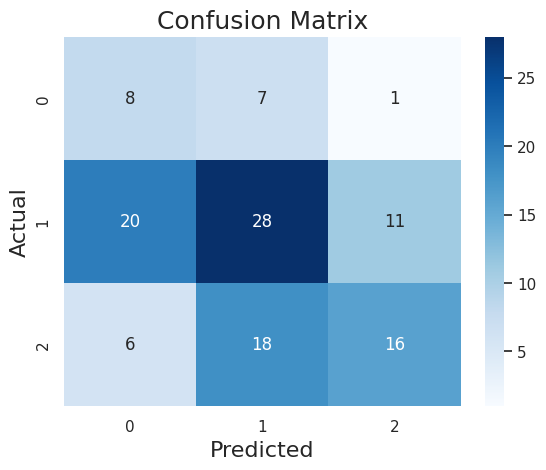

Accuracy for 0 Marks: 50.0%
Accuracy for 1 Marks: 47.46%
Accuracy for 2 Marks: 40.0%

Overall Accuracy: 45.22%


In [ ]:
make_cm(df_all_2_acc['Marks'],df_all_2_acc['W2V_marks'])

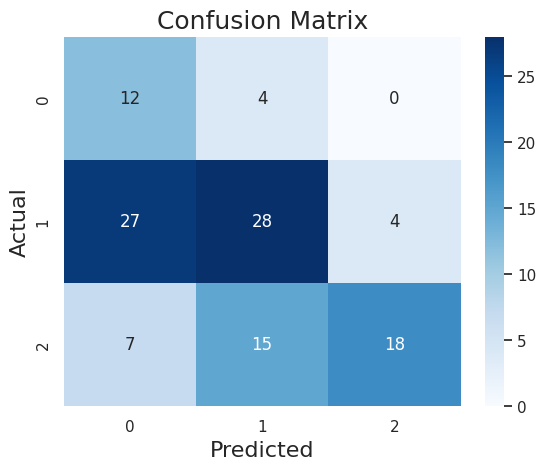

Accuracy for 0 Marks: 75.0%
Accuracy for 1 Marks: 47.46%
Accuracy for 2 Marks: 45.0%

Overall Accuracy: 50.43%


In [ ]:
make_cm(df_all_2_acc['Marks'],df_all_2_acc['SS_marks'])